In [1]:
##Esophogeal Masterbook!!!!
import numpy as np
import os
import pandas as pd
from glob import glob
import glob
import matplotlib.pyplot as plt
from skimage.draw import disk
from skimage import io
import time
import math
import matplotlib.patches as patches
from openpyxl import load_workbook
import fnmatch
import cv2
from tkinter import *
from PIL import ImageTk, Image, ImageDraw
import scipy.ndimage as ndimage
from scipy.ndimage import gaussian_filter
import matplotlib.colors as mcolors
import spectral.io.envi as envi
import tifffile as tif


In [2]:
import PIL

#This function gives a timestamp down to the minute-
def timestamp():
    named_tuple = time.localtime() # get struct_time
    time_string = time.strftime("%Y%m%d_%H%M", named_tuple)
    return(time_string)

def get_x_and_y(event):
    global lasx, lasy
    lasx, lasy = event.x, event.y

def paint(event):
    print('Double clicked at x = % d, y = % d'%(event.x, event.y))
    global hypoth_rad
    rad_xval=event.x
    rad_yval=event.y
    hypoth_rad=int(np.sqrt((rad_xval-center_xval)**2+(rad_yval-center_yval)**2))
    (x1,y1)=(center_xval-hypoth_rad,center_yval-hypoth_rad)
    (x2,y2)=(center_xval+hypoth_rad,center_yval+hypoth_rad)
    canvas.create_oval(x1, y1, x2, y2, outline="red",fill="",width=2)
    
def pressed2(event):
    print('Button-2 pressed at x = % d, y = % d'%(event.x, event.y))
    global center_xval, center_yval
    center_xval=event.x
    center_yval=event.y
    canvas.create_oval(center_xval-2, center_yval-2, center_xval+2, center_yval+2, outline="blue",fill="blue",width=4)
    return()
    
def save():
    global saved_center, saved_rad
    saved_center=(center_xval,center_yval)
    saved_rad=hypoth_rad

#Will clear everything and reload image    
def clear():
    canvas.delete('all')
    canvas.create_image(center[1],center[0], image = mask_ref_image)
    
#Draw Mask to be saved to data folder if desired, masks can also be loaded directly in the next cell-
def circle_masker(dataimage):
    #Put data image in the correct format so it can be used as a reference-
    image1=Image.fromarray(dataimage)
    plt.imshow(image1)
    plt.show()
  
    width = dataimage.shape[1] # canvas width
    height = dataimage.shape[0] # canvas height
    
    global center 
    center=(int(height/2),int(width/2))

    master = Tk()
    global mask_ref_image
    mask_ref_image =  ImageTk.PhotoImage(image1) 
    # create a tkinter canvas to draw on
    global canvas
    canvas = Canvas(width=width, height=height, bg='white')
    canvas.create_image(center[1],center[0], image = mask_ref_image)
    canvas.pack()

    canvas.pack(expand=YES, fill=BOTH)
    #When left click happens choose center
    canvas.bind('<Button-3>', pressed2)
    #When right click happens choose radius and draw circle
    canvas.bind("<Double 1>", paint)

    # add a button to save the image
    button1=Button(text="save",command=save)
    button2=Button(text="clear",command=clear)
    button1.pack()
    button2.pack()

    master.mainloop()
    
    return(saved_center, saved_rad)

In [3]:
def mode_pointing_fnc(mode_path,masterfile_row):
    mode=masterfile_row[2]
    if mode == "AF":
        #Passing center and radius to these for not, may ultimately be more efficient to pass the masterfile though-
        ModeInfo=AF_proc_fnc(mode_path)
    elif mode == "HS":
        ModeInfo=HS_proc_fnc(mode_path)
    elif mode == "OCT":
        #Should maybe find a better way to set OCT height but for now it's being input manually
        height=masterfile_row[7]
        ModeInfo=OCT_proc_fnc(mode_path,height)
    elif mode == "OCTY":
        #Should maybe find a better way to set OCT height but for now it's being input manually
        height=masterfile_row[7]
        ModeInfo=OCTY_proc_fnc(mode_path,height)
    elif mode == "POL":
        ModeInfo=POL_proc_fnc(mode_path)
    else:
        print("Mode Error", mode_path, " Skipped")
        ModeInfo={}        
    return(ModeInfo)

In [4]:
def AF_proc_fnc(folderpath):
    print(folderpath)  
    #We'll need to look through some of the AF data to see if this file is consistantly bright for this part.
    subs=["ILL400_500LP","ILL400_LP500"]
   # maskfile=[i for i in os.listdir(folderpath) if subs in i][0]
    maskfile=[i for i in os.listdir(folderpath) if any(t in i for t in subs)][0]
    #Load in file
    image = Image.open(os.path.join(folderpath,maskfile))
    dataimage=np.asarray(image).astype('float32')
    xshape=int(dataimage.shape[1]/10)
    yshape=int(dataimage.shape[0]/10)   
    dataimage=cv2.resize(dataimage,(xshape,yshape))
    dataimage=dataimage/np.max(dataimage)
    dataimage = (dataimage * 2000).astype(np.uint8)
    np.where(dataimage>255,255,dataimage)
    saved_center, saved_rad=circle_masker(dataimage)
    #Scale back up to account for scale down-
    saved_center=(saved_center[0]*10,saved_center[1]*10)
    saved_rad=saved_rad*10
    return(saved_center, saved_rad)
                                       
# HyperSpectral
def HS_proc_fnc(folderpath):
    print(folderpath)
    head_path=[f for f in os.listdir(folderpath) if f.endswith('.hdr')][0]
    header_file= os.path.join(folderpath, head_path)
    spec_path = [f for f in os.listdir(folderpath) if f.endswith('.raw')][0]
    spectral_file= os.path.join(folderpath, spec_path)
    hspectdata = envi.open(header_file, spectral_file)
    #Similar to AF look through data to find bright file-
    dataimage= hspectdata.read_band(84)
    print(dataimage.shape)
    xshape=int(dataimage.shape[1]/4)
    yshape=int(dataimage.shape[0]/4)
    dataimage=cv2.resize(dataimage,(xshape,yshape))
    dataimage=dataimage/np.max(dataimage)
    dataimage = (dataimage * 500).astype(np.uint8)
    np.where(dataimage>255,255,dataimage)
    saved_center, saved_rad=circle_masker(dataimage)
    #Scale back up to account for scale down-
    saved_center=(saved_center[0]*4,saved_center[1]*4)
    saved_rad=saved_rad*4
    return(saved_center, saved_rad) 

def OCT_proc_fnc(folderpath,height):
    print(folderpath)
    oct_cube = io.imread(os.path.join(folderpath,os.listdir(folderpath)[0]))
    print(oct_cube.shape)
    height=OCT_SelectHeight(oct_cube)
    #Would be nice to generalize height selection but for now will use 400 and see if it works for everyone-
#    height=400
    #Select Later of interest
    oct_layer=oct_cube[:,height,:,0]
    #Need to reshape to account for "physical aspect ratio" thing in some cases-
    if oct_layer.shape[1]>2*oct_layer.shape[0]:
            #resize takes shape as (x,y) so the order needs to be swapped from shape which is (y,x)
            new_shape=(int(oct_layer.shape[1]*0.288),oct_layer.shape[0])
            oct_layer=cv2.resize(oct_layer, (new_shape), interpolation = cv2.INTER_LINEAR)
    
    print(oct_layer.shape)
    dataimage=np.asarray(oct_layer).astype('float32')
    xshape=int(dataimage.shape[1]/2)
    yshape=int(dataimage.shape[0]/2)
    dataimage=cv2.resize(dataimage,(xshape,yshape))
    print(dataimage.shape)
    dataimage=dataimage/np.max(dataimage)
    dataimage = (dataimage * 300).astype(np.uint8)
    np.where(dataimage>255,255,dataimage)
    saved_center, saved_rad=circle_masker(dataimage)
    #Scale back up to account for scale down-
    saved_center=(saved_center[0]*2,saved_center[1]*2)
    saved_rad=saved_rad*2
    return(saved_center, saved_rad, height) 
    
def OCTY_proc_fnc(folderpath,height):
    folderpath = folderpath.rstrip(folderpath[-1])
    print(folderpath)
    oct_cube = io.imread(os.path.join(folderpath,os.listdir(folderpath)[0]))
    print(oct_cube.shape)
    height=OCTY_SelectHeight(oct_cube)
    #Would be nice to generalize height selection but for now will use 400 and see if it works for everyone-
#    height=400
    #Select Later of interest
    oct_layer=oct_cube[height,:,:,0]
    #Need to reshape to account for "physical aspect ratio" thing in some cases-
    
    dataimage=np.asarray(oct_layer).astype('float32')
    xshape=int(dataimage.shape[1]/2)
    yshape=int(dataimage.shape[0]/2)
    dataimage=cv2.resize(dataimage,(xshape,yshape))
    dataimage=dataimage/np.max(dataimage)
    dataimage = (dataimage * 500).astype(np.uint8)
    np.where(dataimage>255,255,dataimage)
    saved_center, saved_rad=circle_masker(dataimage)
    #Scale back up to account for scale down-
    saved_center=(saved_center[0]*2,saved_center[1]*2)
    saved_rad=saved_rad*2
    return(saved_center, saved_rad, height) 

def POL_proc_fnc(folderpath):
    print(folderpath)
    polardecomp_path=os.path.join(folderpath, "polardecomp")
    #Might want some handling here to allow for missing wave data-                                
    wavepath=os.path.join(polardecomp_path, str(442)+".npz")                                
    wavefile=np.load(wavepath)                                
    dataimage=wavefile['depol']
    dataimage=cv2.resize(dataimage,(512,512))
    dataimage = (dataimage * 255).astype(np.uint8)
    np.where(dataimage>255,255,dataimage)
    saved_center, saved_rad=circle_masker(dataimage)
    #Scale back up to account for scale down-
    saved_center=(saved_center[0]*2,saved_center[1]*2)
    saved_rad=saved_rad*2
    return(saved_center, saved_rad)     
              

In [5]:
def OCT_SelectHeight(octfile):
    zrange=octfile.shape[1]
    zstep=int(np.floor(zrange/20))
    if zstep==0:
        zstep=1
    for i in range(20):
        print(zstep*i)
        oct_layer=octfile[:,zstep*i,:,:]
        if oct_layer.shape[1]>2*oct_layer.shape[0]:
            #resize takes shape as (x,y) so the order needs to be swapped from shape which is (y,x)
            new_shape=(int(oct_layer.shape[1]*0.288),oct_layer.shape[0])
            oct_layer=cv2.resize(oct_layer, (new_shape), interpolation = cv2.INTER_LINEAR)
        plt.imshow(oct_layer)
        plt.show()
    print(oct_layer.shape)
    print('What Slice looks good?')
    x = input()
    print('Wow What a good choice, ' + x)
    height=int(x)
    return(height)

def OCTY_SelectHeight(octfile):
    dim1=octfile.shape[0]
    iterations=int(np.floor(dim1/20))
    for i in range(iterations):
        print(20*i)
        oct_layer=octfile[20*i,::,:]
        plt.imshow(oct_layer)
        plt.show()
    
    print('What Slice looks good gorgeous?')
    x = input()
    print('Wow What a good choice, ' + x)
    height=int(x)
    return(height)


Q:\BOOM\EsophagealCancerStudy\Data_For_Processing\ID255
AF data not collected
HS data not collected
OCT data not collected
OCTY data not collected
POL already has mask info
Q:\BOOM\EsophagealCancerStudy\Data_For_Processing\ID251
AF already has mask info
HS already has mask info
OCT data not collected
OCTY data not collected
POL already has mask info
Q:\BOOM\EsophagealCancerStudy\Data_For_Processing\ID251
AF data not collected
HS already has mask info
OCT data not collected
OCTY data not collected
POL already has mask info
Q:\BOOM\EsophagealCancerStudy\Data_For_Processing\ID258
AF already has mask info
HS already has mask info
OCT data not collected
OCTY data not collected
POL already has mask info
Q:\BOOM\EsophagealCancerStudy\Data_For_Processing\ID258
AF already has mask info
HS already has mask info
OCT data not collected
OCTY data not collected
POL already has mask info
Q:\BOOM\EsophagealCancerStudy\Data_For_Processing\ID259
AF already has mask info
HS already has mask info
OCT data

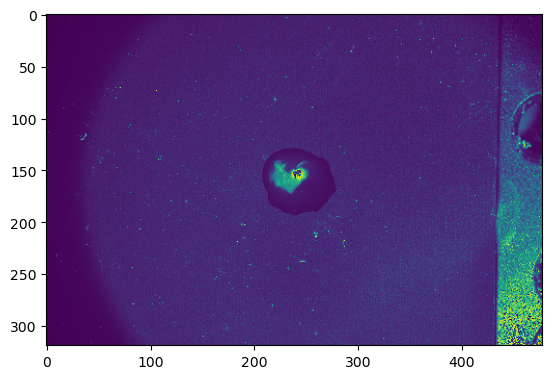

Button-2 pressed at x =  233, y =  162
Double clicked at x =  222, y =  166
Button-2 pressed at x =  234, y =  162
Double clicked at x =  232, y =  153
Length 2
Q:\BOOM\EsophagealCancerStudy\Data_For_Processing\ID376\Barretts\HS
(1200, 1024)


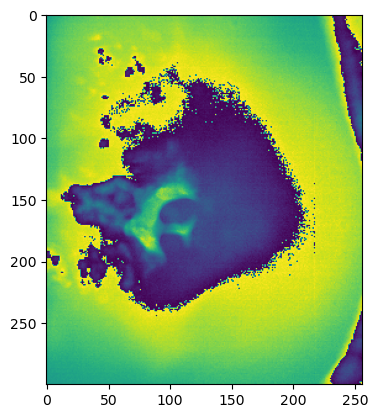

Button-2 pressed at x =  81, y =  170
Double clicked at x =  33, y =  121
Button-2 pressed at x =  108, y =  172
Double clicked at x =  87, y =  102
Button-2 pressed at x =  68, y =  163
Double clicked at x =  16, y =  139
Length 2
Q:\BOOM\EsophagealCancerStudy\Data_For_Processing\ID376\Barretts\OCT
(287, 1024, 1241, 4)
0


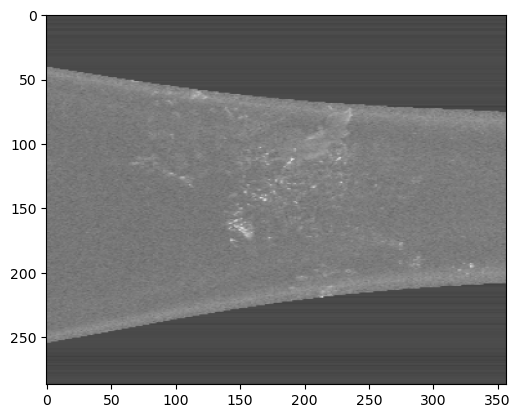

51


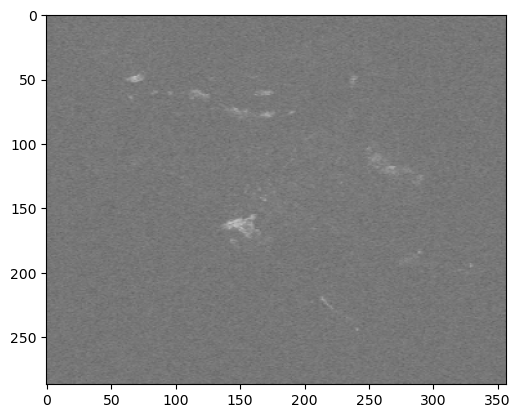

102


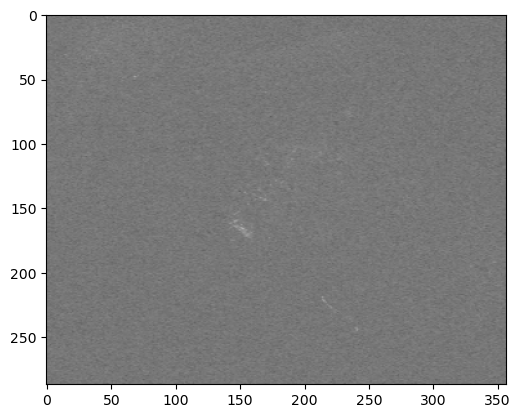

153


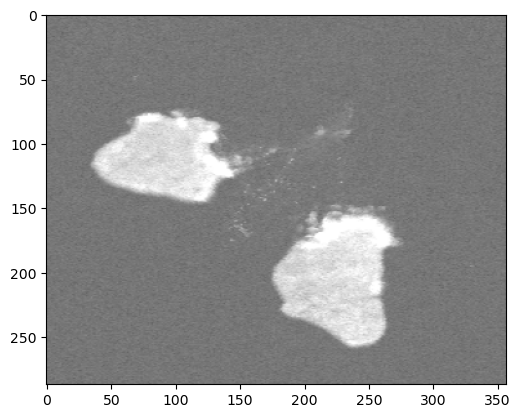

204


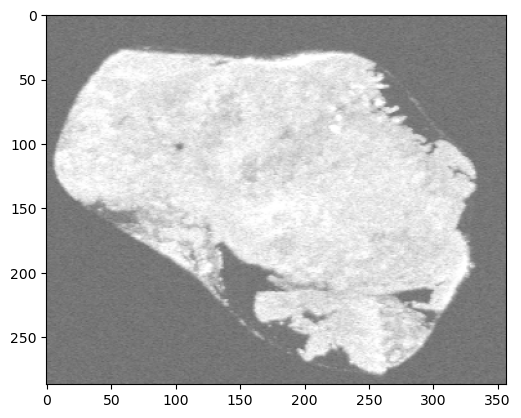

255


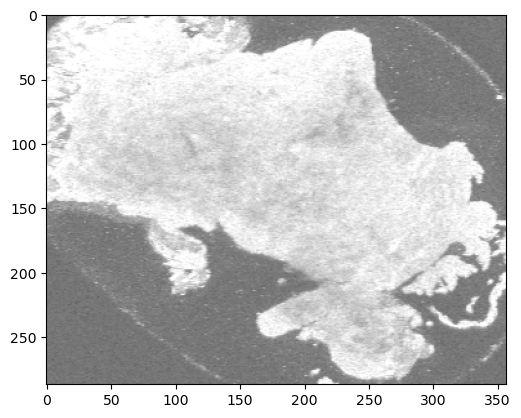

306


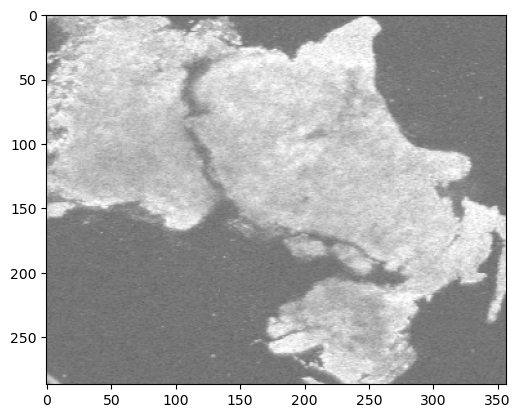

357


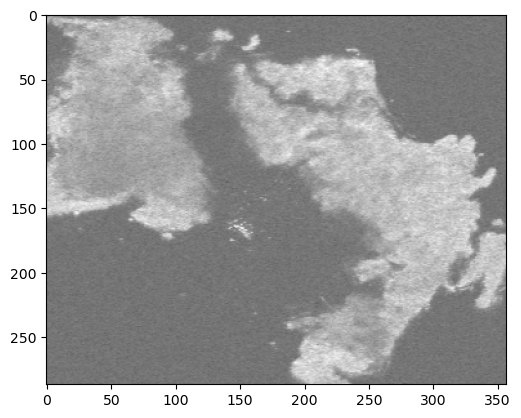

408


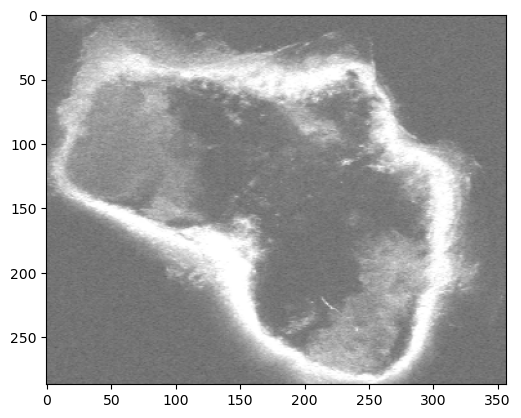

459


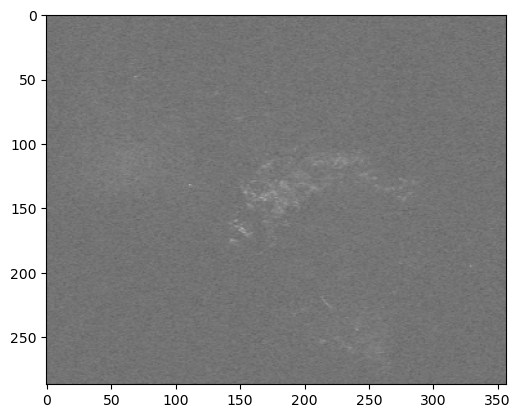

510


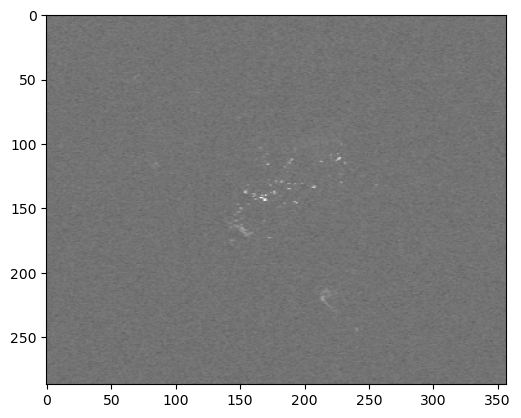

561


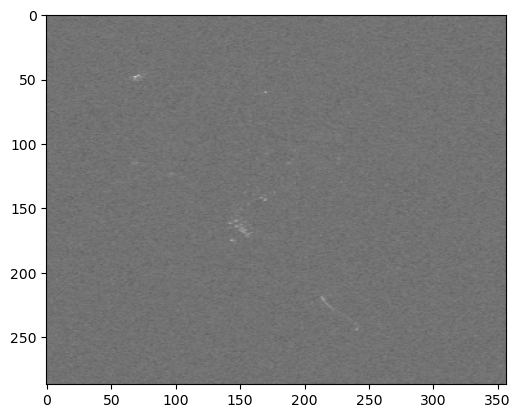

612


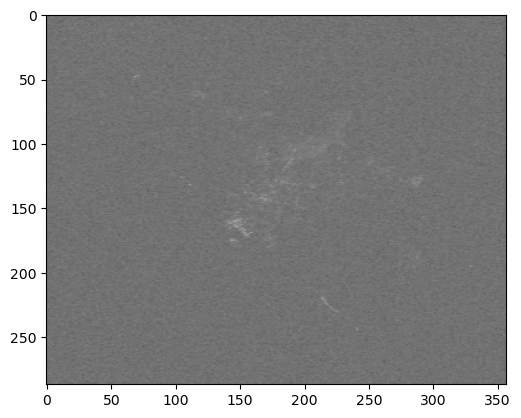

663


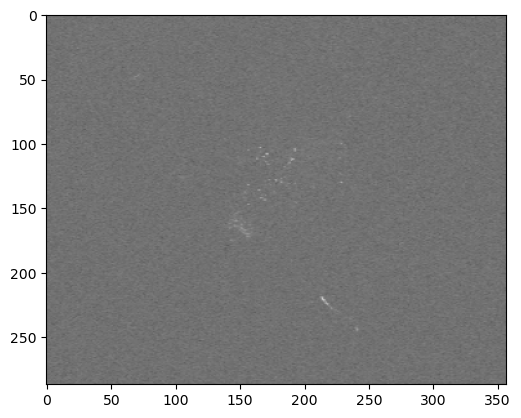

714


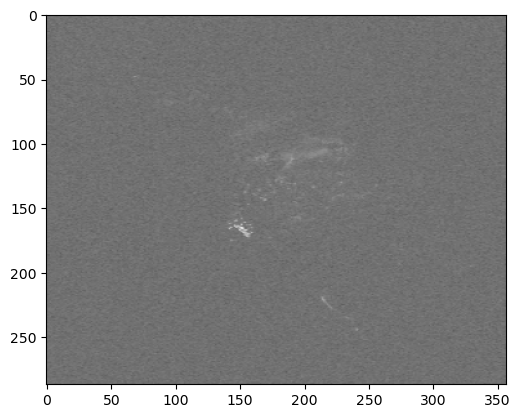

765


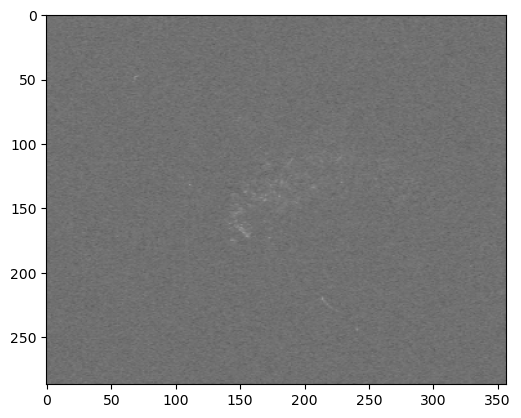

816


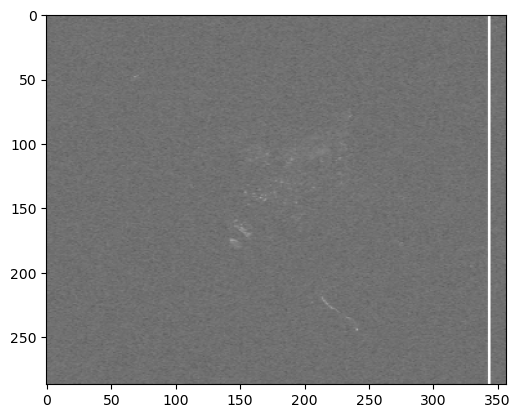

867


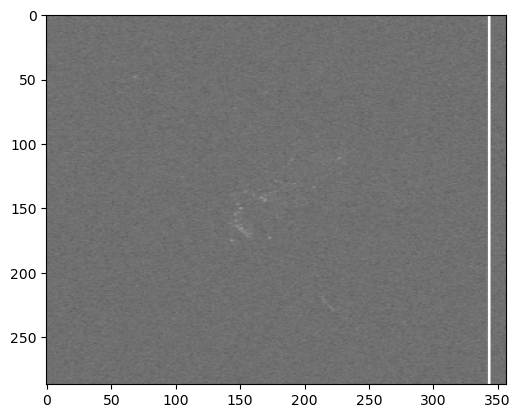

918


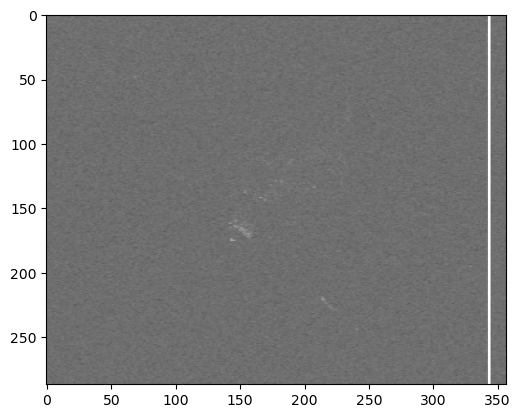

969


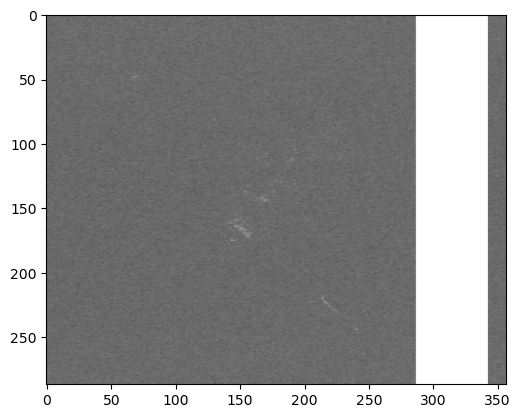

(287, 357, 4)
What Slice looks good?
220
Wow What a good choice, 220
(287, 357)
(143, 178)


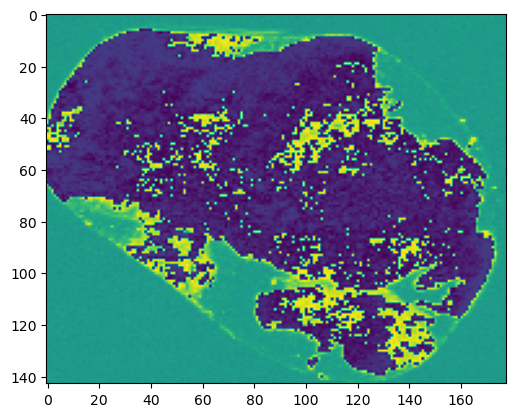

Button-2 pressed at x =  59, y =  46
Double clicked at x =  48, y =  14
Button-2 pressed at x =  81, y =  53
Double clicked at x =  76, y =  22
Button-2 pressed at x =  95, y =  61
Double clicked at x =  128, y =  41
Length 3
Q:\BOOM\EsophagealCancerStudy\Data_For_Processing\ID376\Barretts\OCT
(287, 1024, 1241, 4)
0


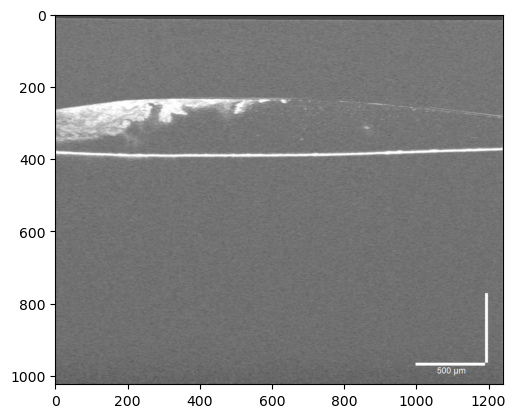

20


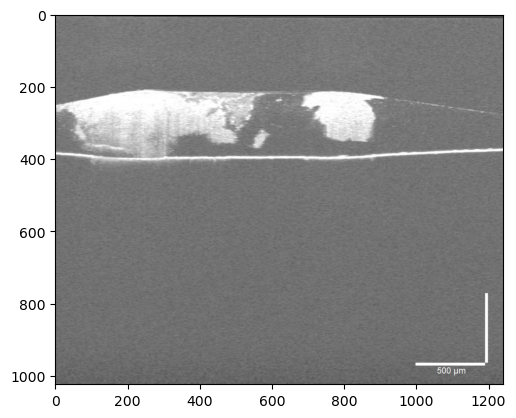

40


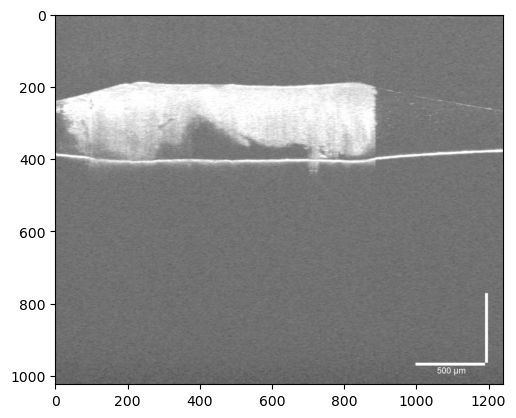

60


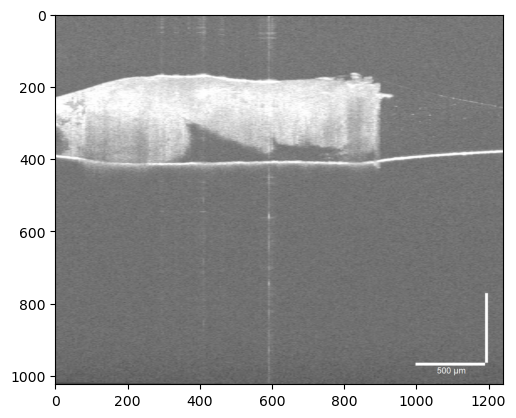

80


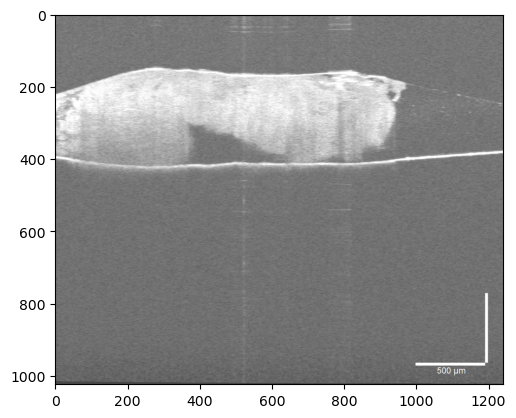

100


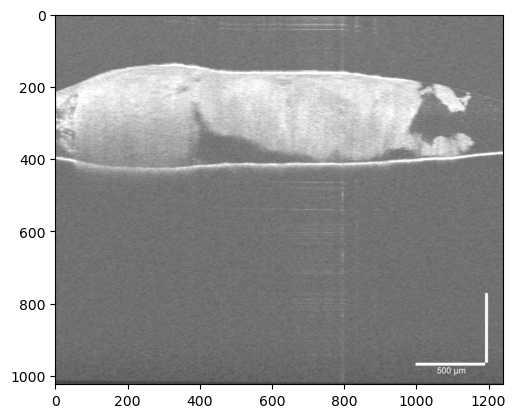

120


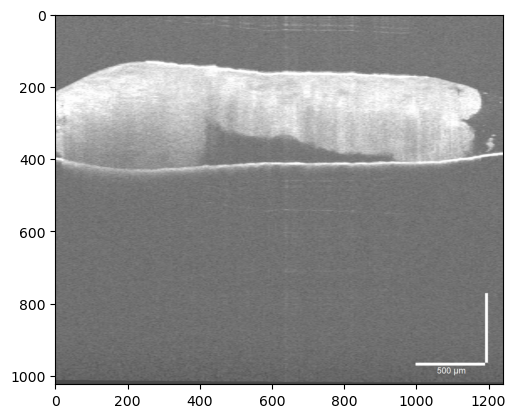

140


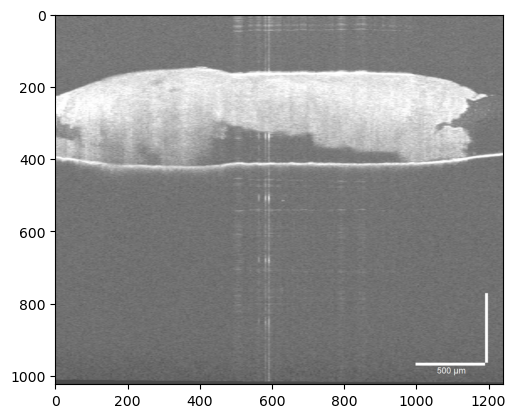

160


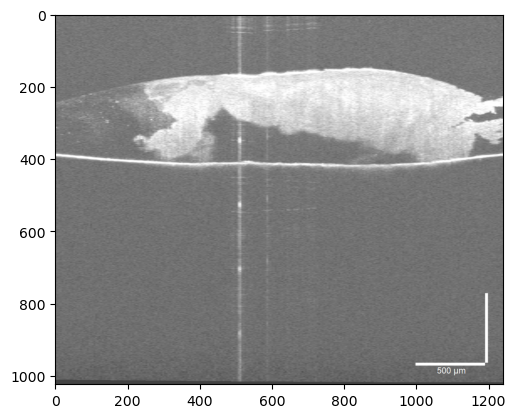

180


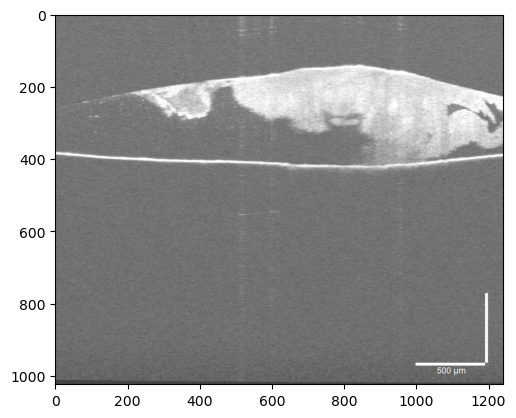

200


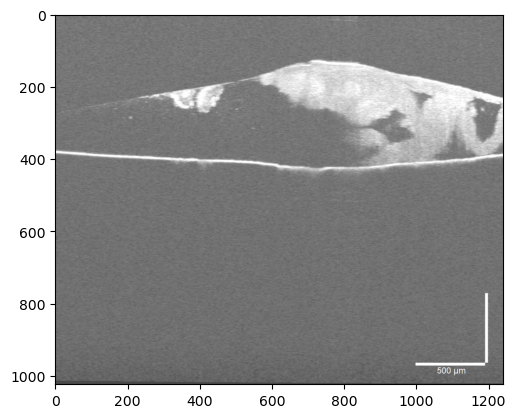

220


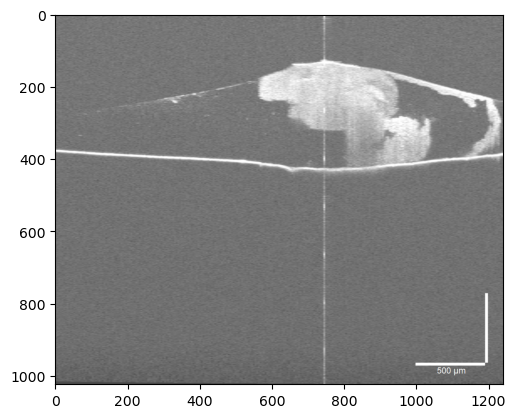

240


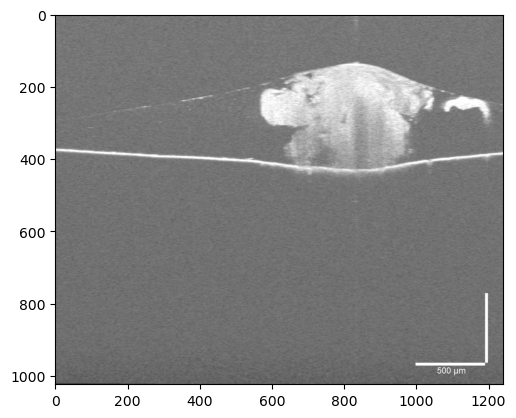

260


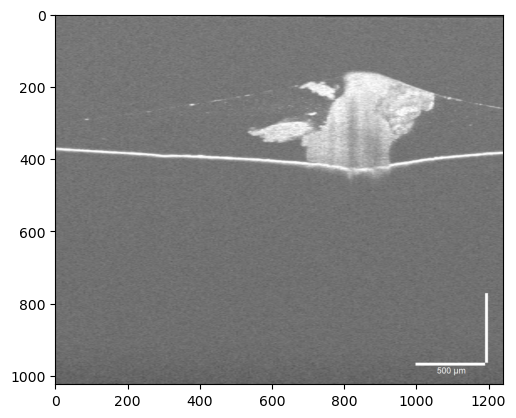

What Slice looks good gorgeous?
100
Wow What a good choice, 100


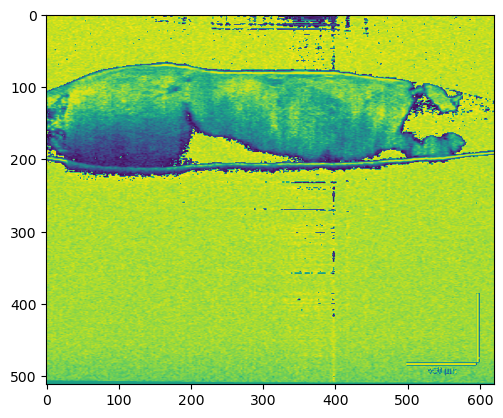

Button-2 pressed at x =  104, y =  143
Double clicked at x =  60, y =  91
Length 3
Q:\BOOM\EsophagealCancerStudy\Data_For_Processing\ID376\Barretts\POL


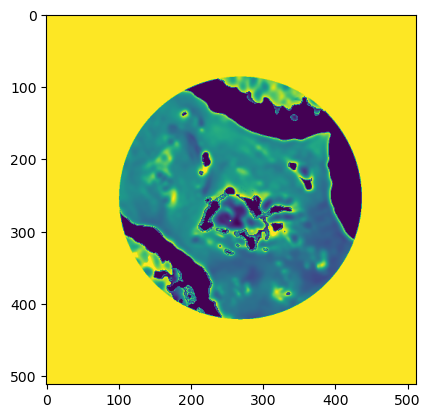

Button-2 pressed at x =  258, y =  278
Double clicked at x =  186, y =  204
Button-2 pressed at x =  266, y =  272
Double clicked at x =  282, y =  183
Length 2


In [7]:
#Import organizing excel doc with relevant info

#Data collection folderpath- 
masterfilepath=r"Q:\BOOM\EsophagealCancerStudy\Data_For_Processing\Esophagealguide1_2025.xlsx"
masterfolder=os.path.split(masterfilepath)[0]
masterfile=np.array(pd.read_excel(masterfilepath, dtype=object, header=None,),dtype=object)

#Empty lists to be filled with resulting data-
Patient_pathlist=[]
processedlist=[]

#Get the patient info and convert it into an array, taking out empty cells in between-
patient_array=np.array(masterfile[1:,0]).astype('float64')
patient_array=patient_array[~np.isnan(patient_array)]

#Searches the data collection doc for which data to process and puts resuling folderpaths into a list-
for i in range(patient_array.shape[0]):
    patient=patient_array[i]
    subfolder=os.path.join(masterfolder, "ID"+ str(int(patient)))
    print(subfolder)
    Patient_pathlist.append(subfolder)
    patient_path=subfolder
    #Get tissue type from excel doc and add to path, assumes 4 spaces between each for the different imaging types-
    #****Would be nice to make this less dependent on the excel doc structure but a fine stand in for now****
    tissue_type=masterfile[1+i*5,1]
    tissue_path=os.path.join(patient_path, tissue_type)
    #Similarly get imaging mode info and make paths for that-
    for j in range(5):
        mode=masterfile[1+j+i*5,2]
        mode_path=os.path.join(tissue_path, mode)
        #Currently added a collomn to tell whether or not this datatype has been collected, could be a more automated way to do this-
        if masterfile[1+j+i*5,3]=='Y':
            #Check if mask info is already there or nah
            if np.isnan(masterfile[1+j+i*5,4]):
                mask_info=mode_pointing_fnc(mode_path, masterfile[1+j+i*5,:])
                #Add mask info to masterfile
                masterfile[1+j+i*5,4]=mask_info[0][0]
                masterfile[1+j+i*5,5]=mask_info[0][1]
                masterfile[1+j+i*5,6]=mask_info[1]
                print("Length",len(mask_info))
                if len(mask_info)==3:
                    masterfile[1+j+i*5,7]=mask_info[2]
            else: print(mode, "already has mask info")
        else: print(mode, "data not collected")
               
#Save that array!
df = pd.DataFrame (masterfile)
excelpath=os.path.join(masterfolder,timestamp() + "Mask_Dataout.xlsx")
with pd.ExcelWriter(excelpath) as writer:
    df.to_excel(writer, startrow=0, startcol=0, header=False, index=False)  

    

In [7]:
## OCT preprocessing proceedure-
#Has to be done one file at a time but it's pretty quick-

#Load in file-
folderpath=r"Q:\BOOM\EsophagealCancerStudy\Data_For_Processing\ID421\Tumor\OCT"
os.chdir(folderpath)
for file in glob.glob("*.tiff")+glob.glob("*.tif"):
    print(file)
oct_cube = io.imread(os.path.join(folderpath,file))


OCT.tif


In [9]:
#Fun to find range of layers in an octcube that are in the desired brightness range-
def find_range(oct_cube):
    print(oct_cube.shape)
    meanlist=[]
#starting with every layer but this will surely take a thousand years so we can skip to ever y 10 or something later-
    #does this work in 3d-
    oct_cube_formean=np.where(oct_cube>200, 0, oct_cube)
    meanaray=np.mean(np.mean(oct_cube_formean[:,:,:,0],axis=0),axis=1)
    #print(meanaray.shape)
    plt.plot(meanaray)
    plt.show()
    for i in range(oct_cube.shape[1]):     
        #Select Layer of interest
        oct_layer=oct_cube[:,i,:,0]
        oct_layer=np.where(oct_layer>200, 0, oct_layer)
        layermean=np.mean(oct_layer)
        #print(i,layermean)
        #adding layers with mean in thr correct range to meanlist-
        if layermean>10 and layermean<110:
            meanlist.append(i)
    #print(meanlist)
    #need to find largest stretch of consecutive numbers in the list-
    consecutive_groups=[]
    length=0
    for i in range(len(meanlist)-1):
        if meanlist[i+1]-meanlist[i]==1:
            length=length+1
        else:
            consecutive_groups.append([i,length])
            length=0
            #Consec_groups are indexes from the meanlist!
    #need to add a stop gap in case that the meanlist ends with a consecutive group-
    consecutive_groups.append([i,length-1])
    print(consecutive_groups)
    consec=np.array(consecutive_groups)
    print(consec)
    consec_range=np.max(consec[:,1])
    #Selecting and organizing the largest consecutive group of values in that range-
    maxconsec=consec[np.argwhere(consec==consec_range)[0,0]]
    consec_start=maxconsec[0]-consec_range
    print(consec_range,consec_start)
    #index range-> indecies from OCT file-
    indexrange=[meanlist[consec_start],meanlist[consec_start+consec_range]]
    print("indexrange",indexrange)
    return(indexrange)

(374, 300, 2069, 4)


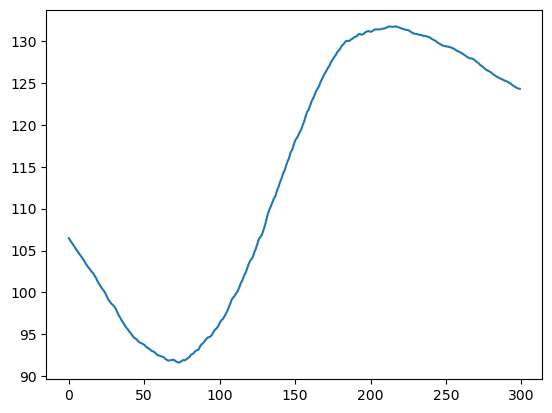

[[132, 132]]
[[132 132]]
132 0
indexrange [0, 132]
0


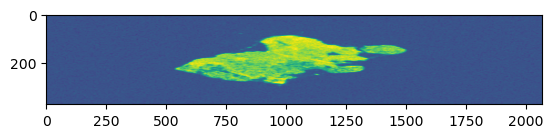

1


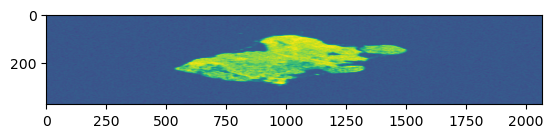

2


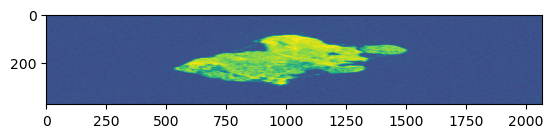

3


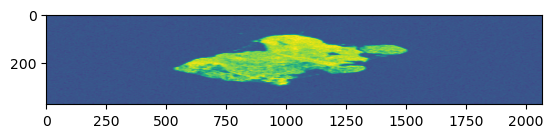

4


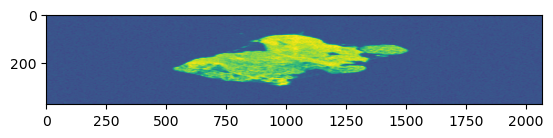

5


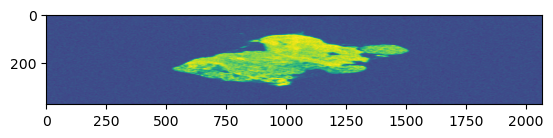

6


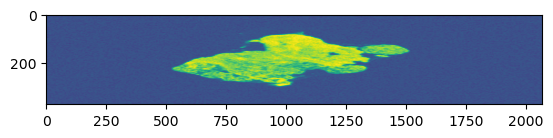

7


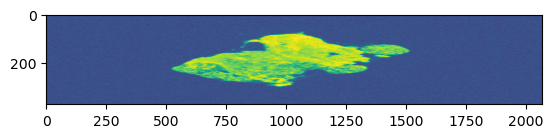

8


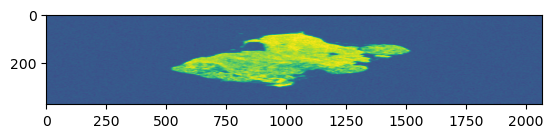

9


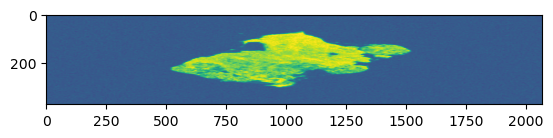

10


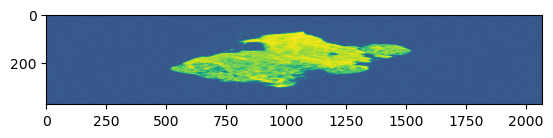

11


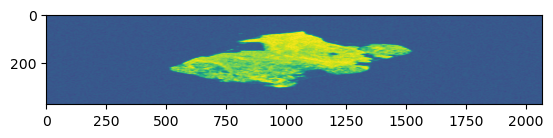

12


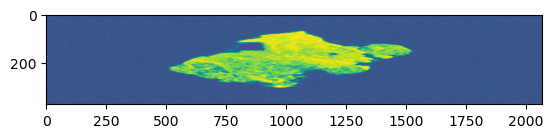

13


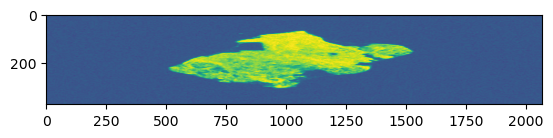

14


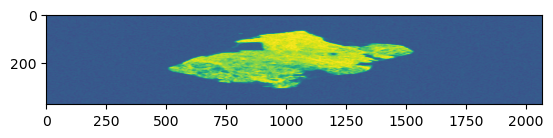

15


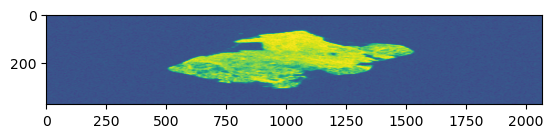

16


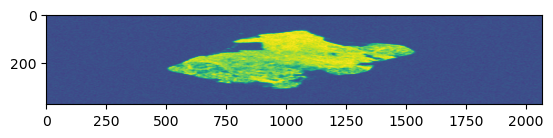

17


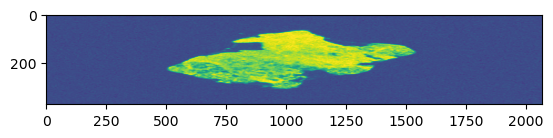

18


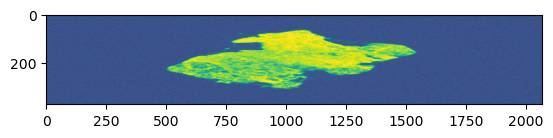

19


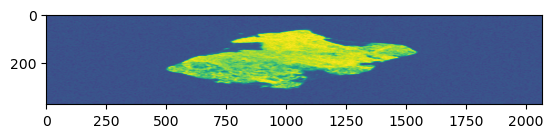

20


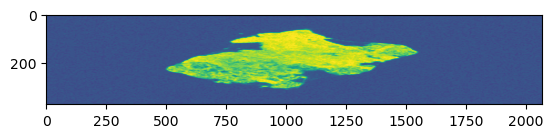

21


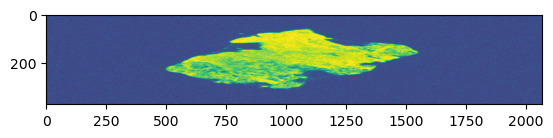

22


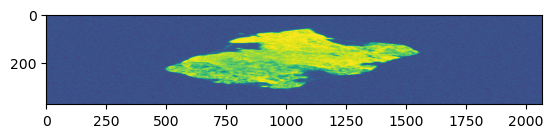

23


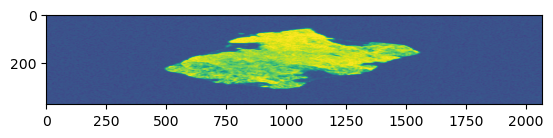

24


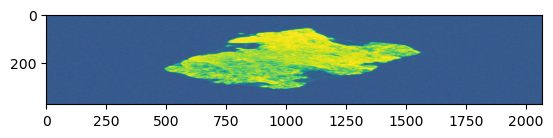

25


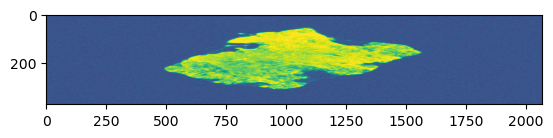

26


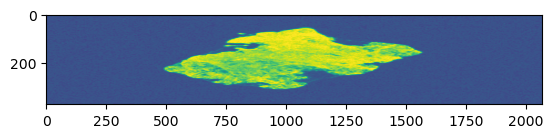

27


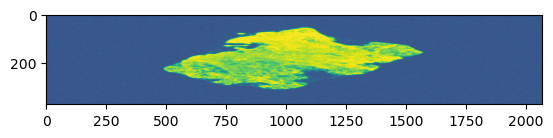

28


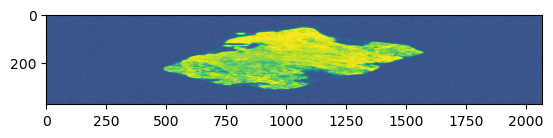

29


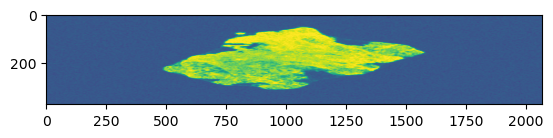

30


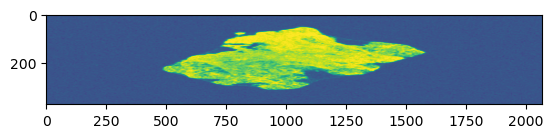

31


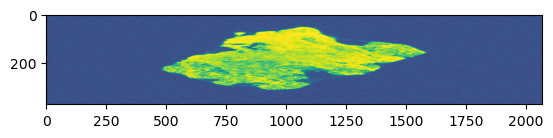

32


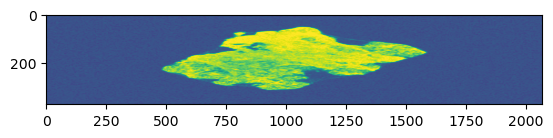

33


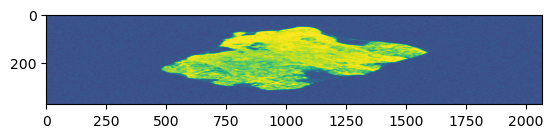

34


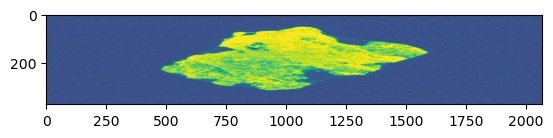

35


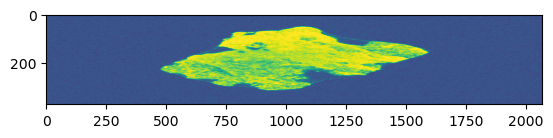

36


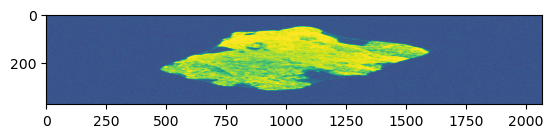

37


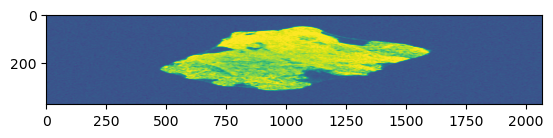

38


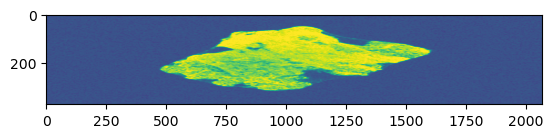

39


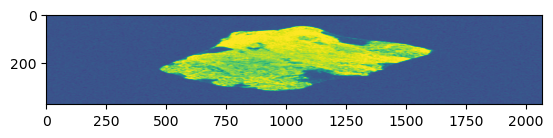

40


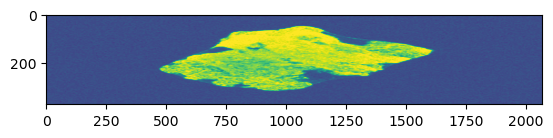

41


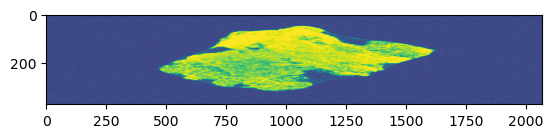

42


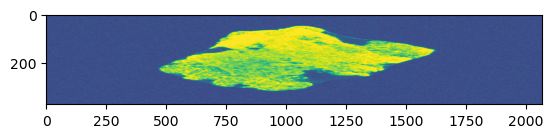

43


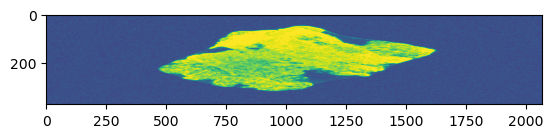

44


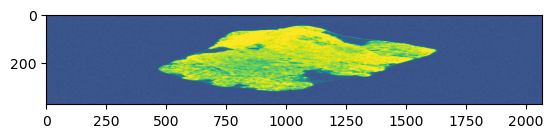

45


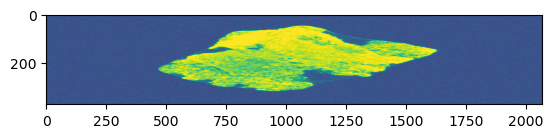

46


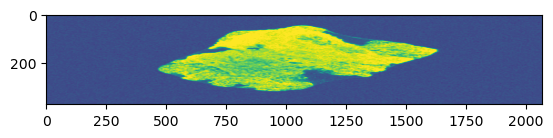

47


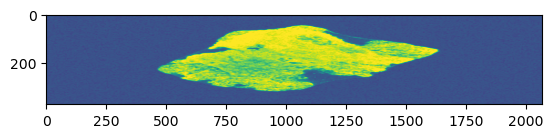

48


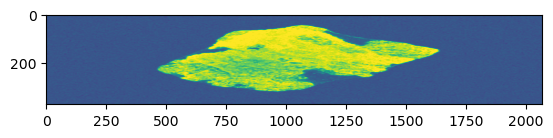

49


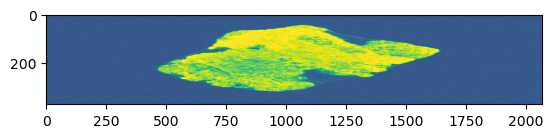

50


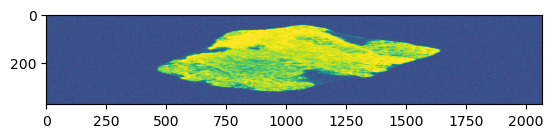

51


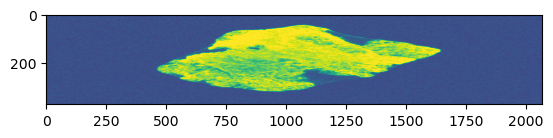

52


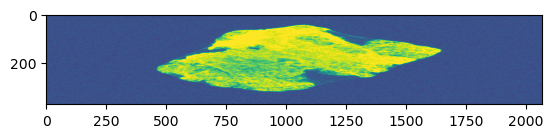

53


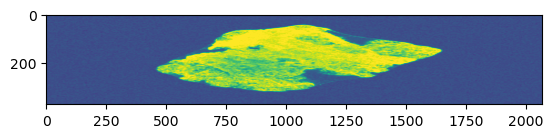

54


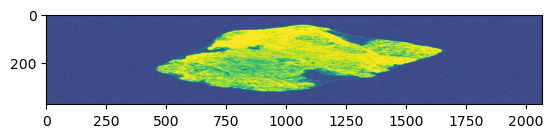

55


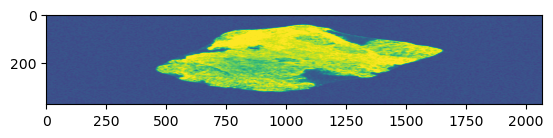

56


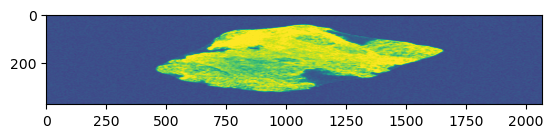

57


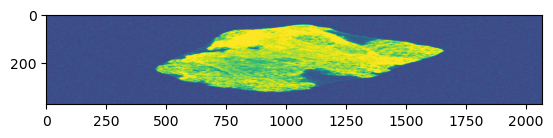

58


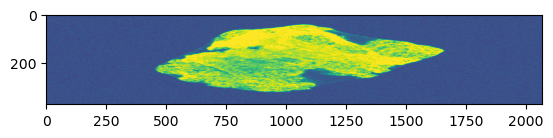

59


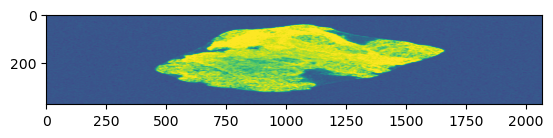

60


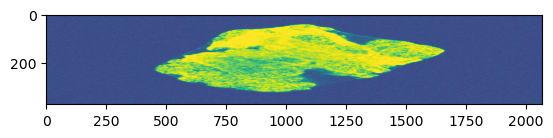

61


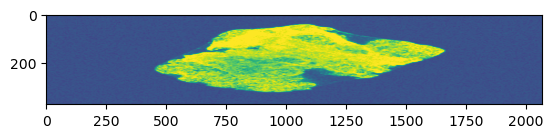

62


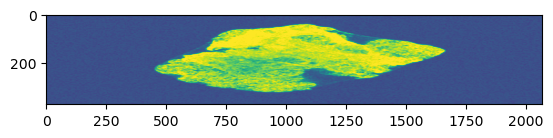

63


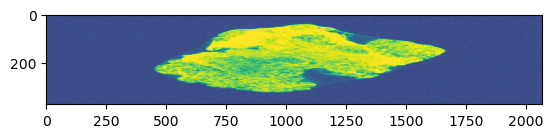

64


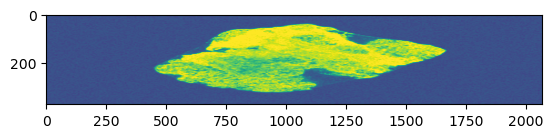

65


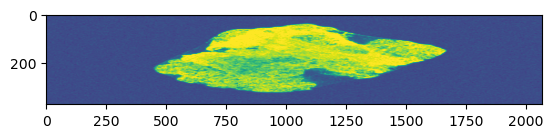

66


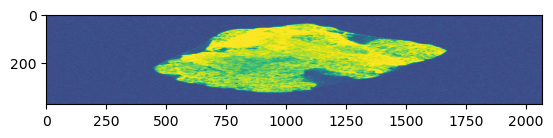

67


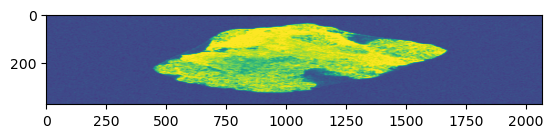

68


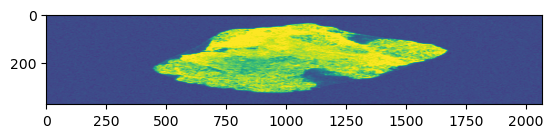

69


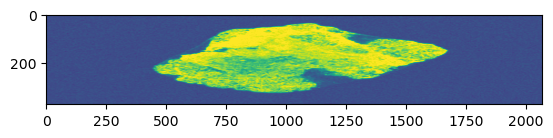

70


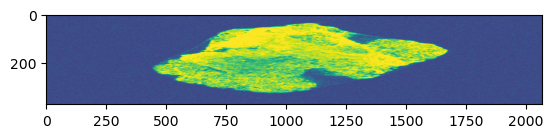

71


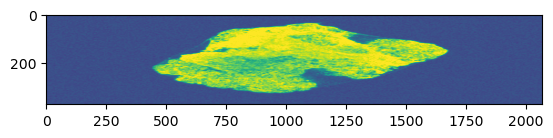

72


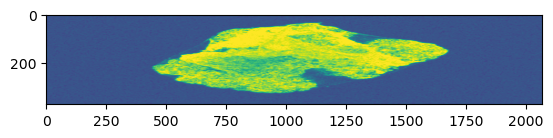

73


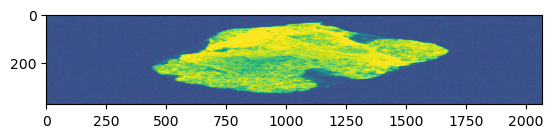

74


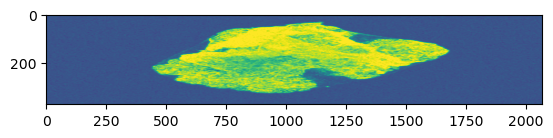

75


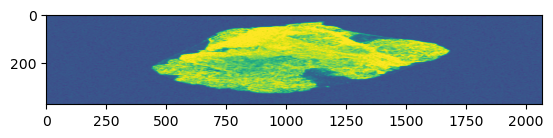

76


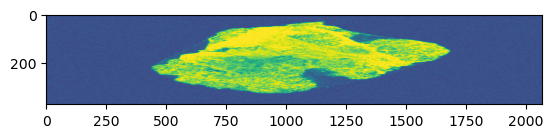

77


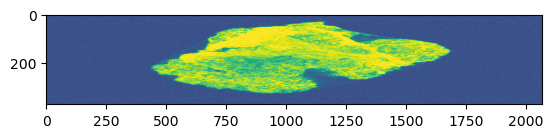

78


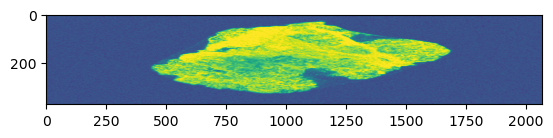

79


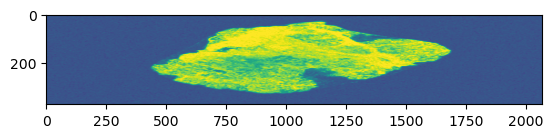

80


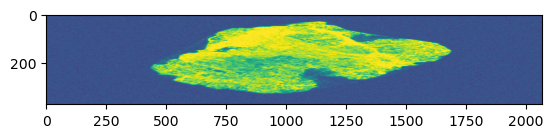

81


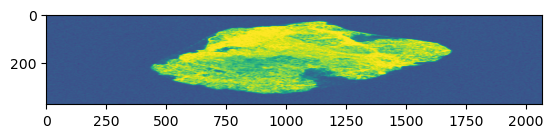

82


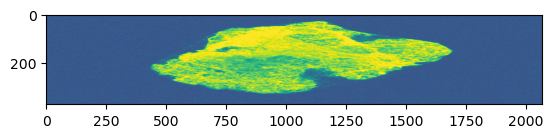

83


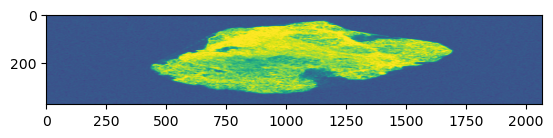

84


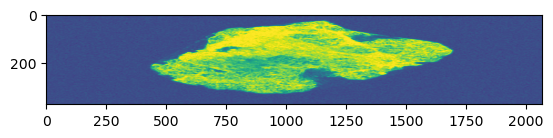

85


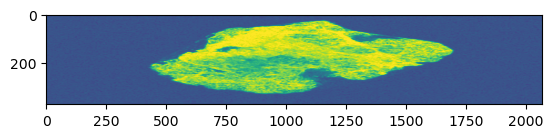

86


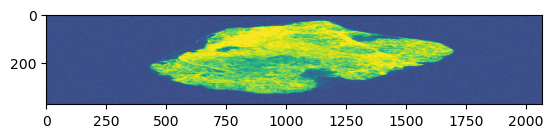

87


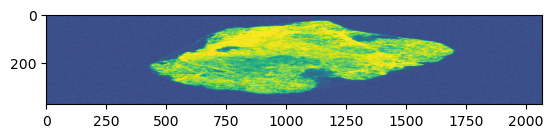

88


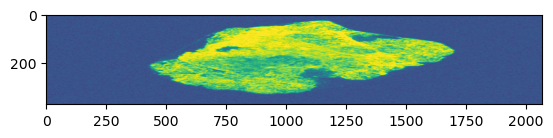

89


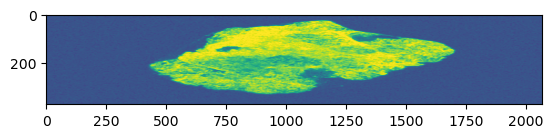

90


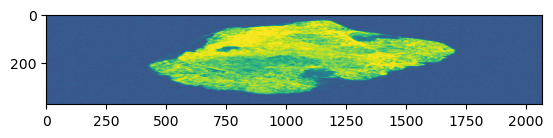

91


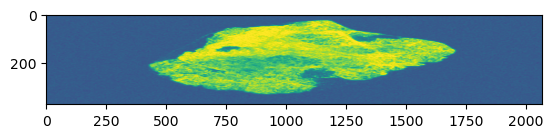

92


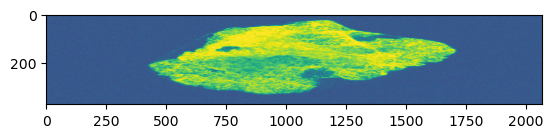

93


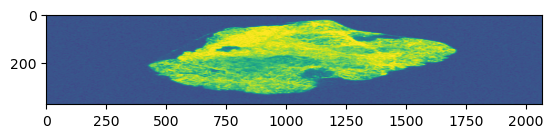

94


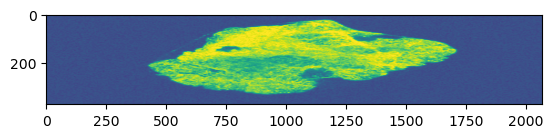

95


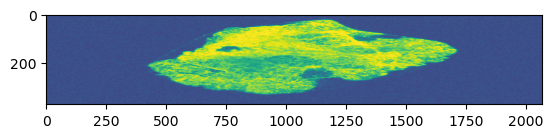

96


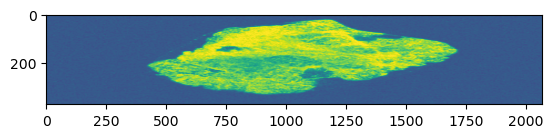

97


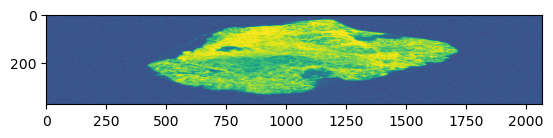

98


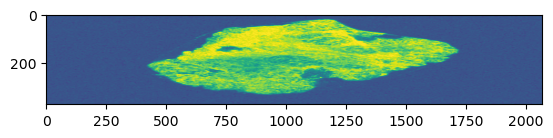

99


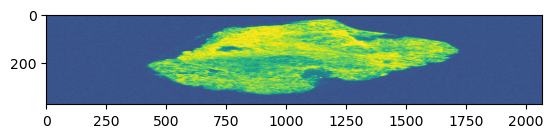

100


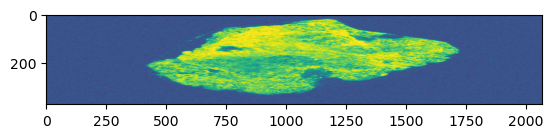

101


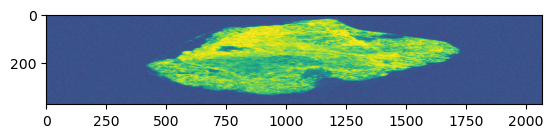

102


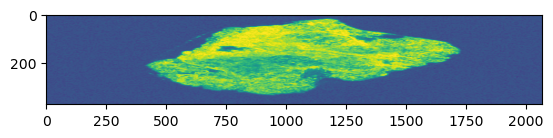

103


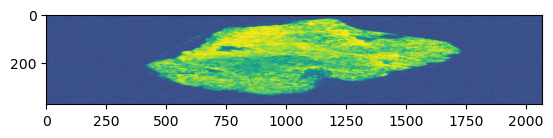

104


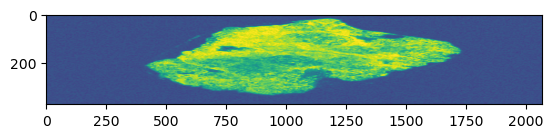

105


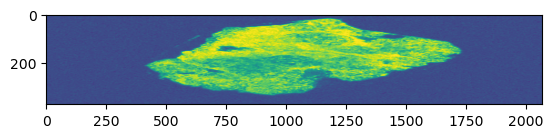

106


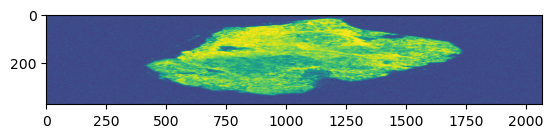

107


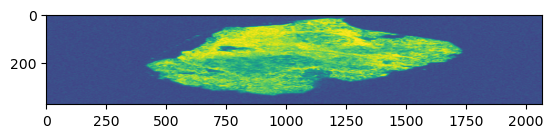

108


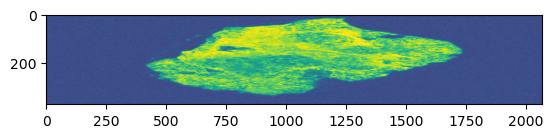

109


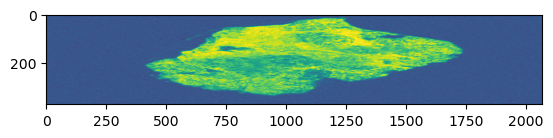

110


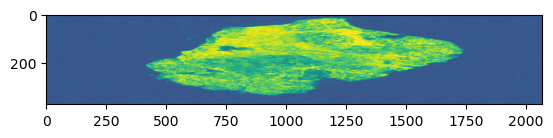

111


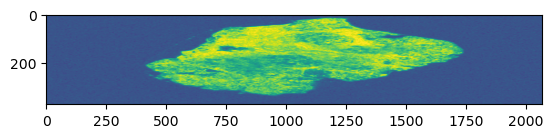

112


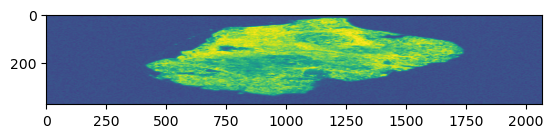

113


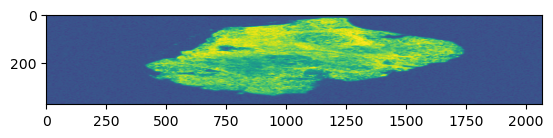

114


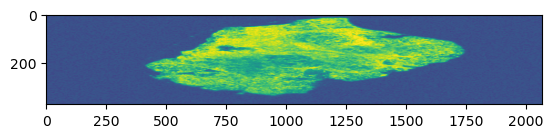

115


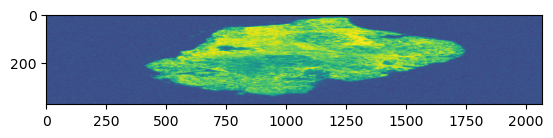

116


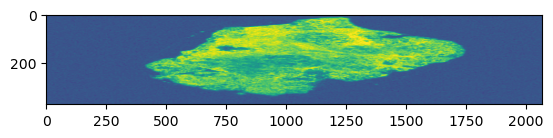

117


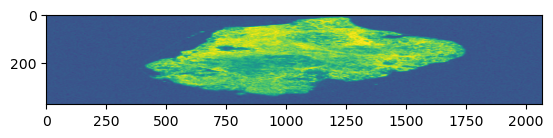

118


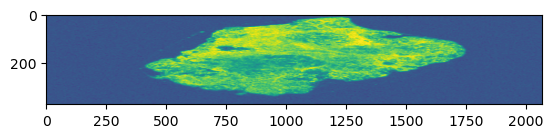

119


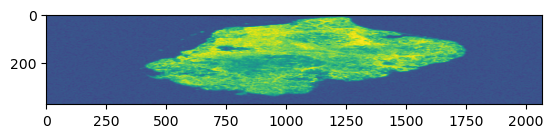

120


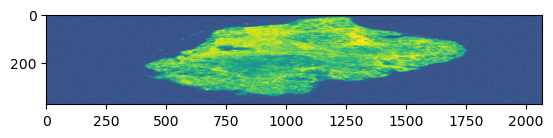

121


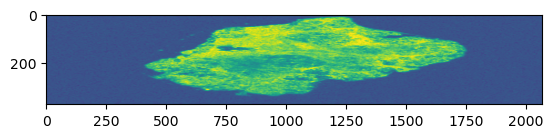

122


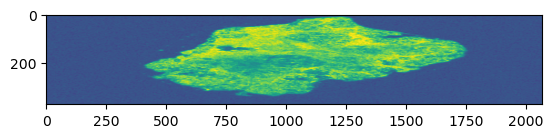

123


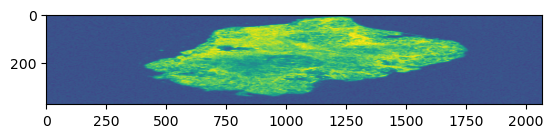

124


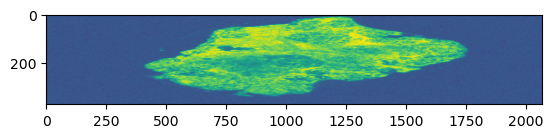

125


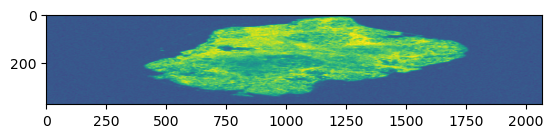

126


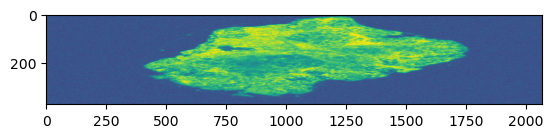

127


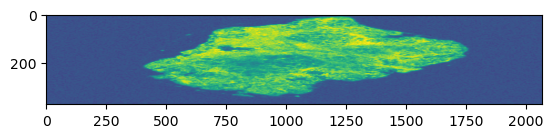

128


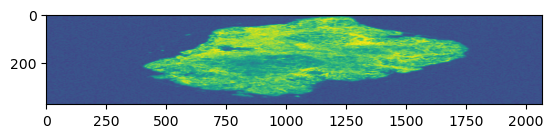

129


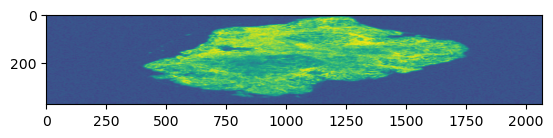

130


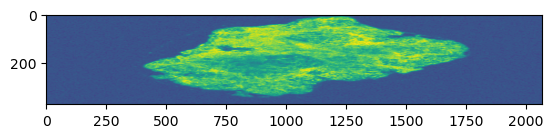

131


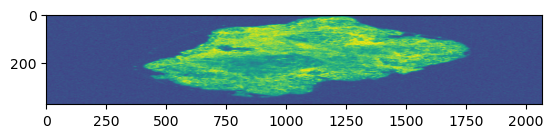

132


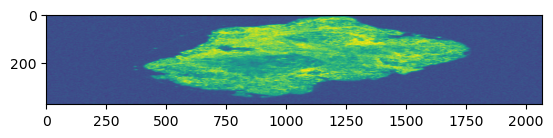

In [10]:
#shows oct files in selected range, if find range function doesn't work layers can be manually entered
def showrange(oct_cube):
    #Find range of levels with the correct brightness-
    indexrange=find_range(oct_cube)
    #Set manually if things are real messed up-
    #indexrange=[150,500]
    #Select octlayers that are in that range-
    consec_oct=oct_cube[:,indexrange[0]:indexrange[1]+1,:,0]
    for j in range(consec_oct.shape[1]):
        oct_layer=consec_oct[:,j,:]
        print(j+indexrange[0])
        plt.imshow(oct_layer)
        plt.show()
    return()

oct_mean=showrange(oct_cube) 

In [13]:
#Trim OCT cube in Z-
Trimmed_Oct_Cube=oct_cube[:,1:130,:,:]

#Flip if needed- (Might not work)
#Trimmed_OCT_Cube=np.flip(Trimmed_Oct_Cube, axis=2)

tif.imsave(r"C:\Users\justinamb\Desktop\OCT.tif",Trimmed_Oct_Cube, bigtiff=True)

In [14]:
#reloading Modified file-
oct_cube_new = io.imread(os.path.join(r"C:\Users\justinamb\Desktop\OCT.tif"))

58
0


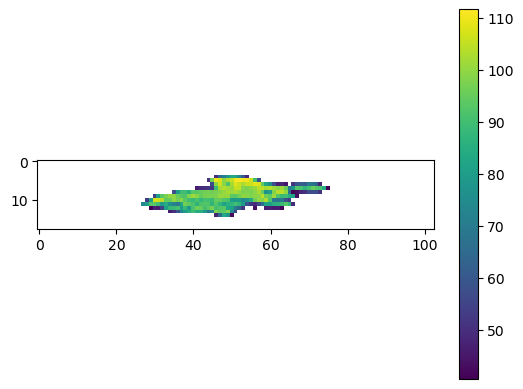

1


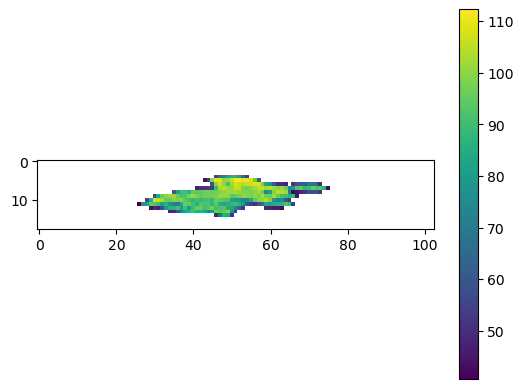

2


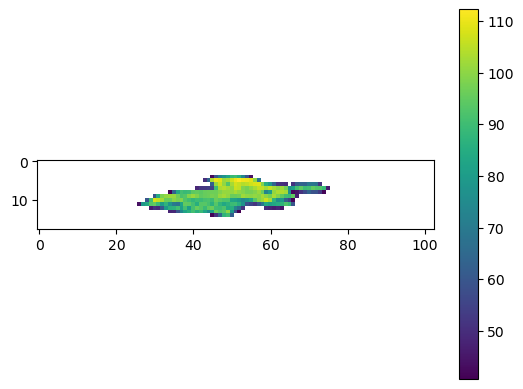

3


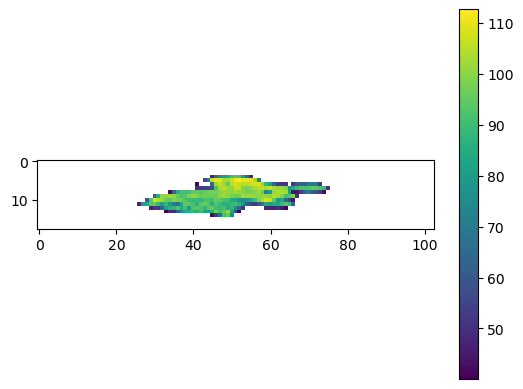

4


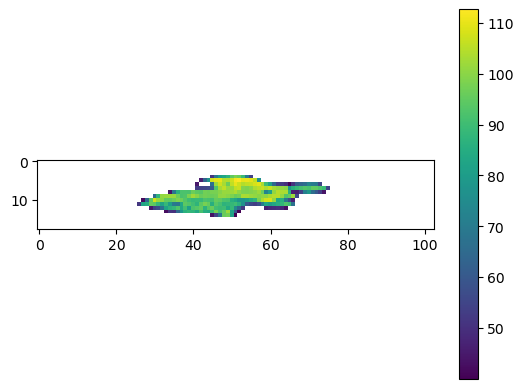

5


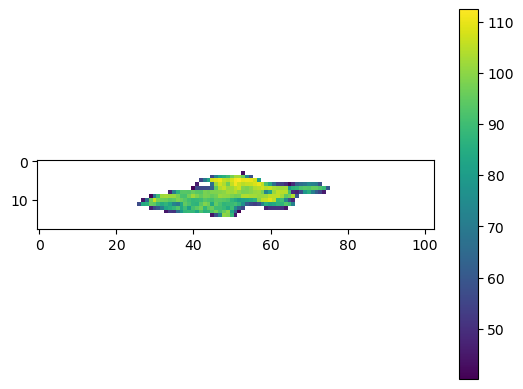

6


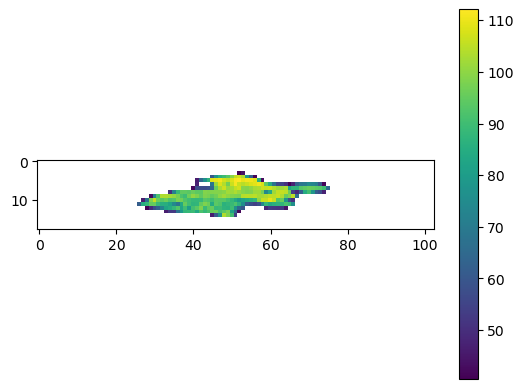

7


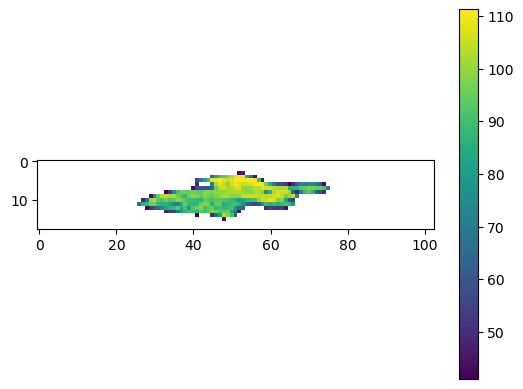

8


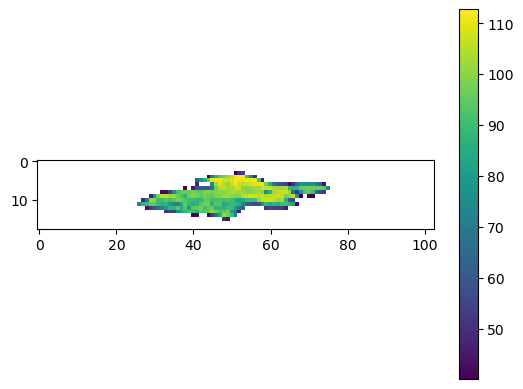

9


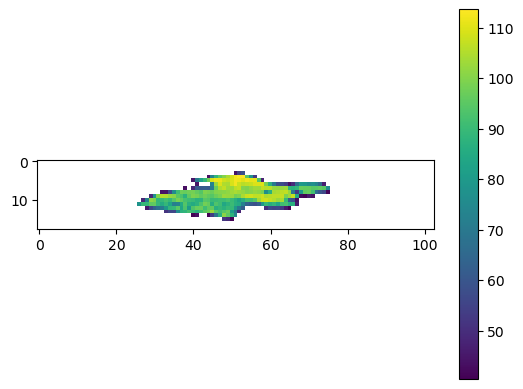

10


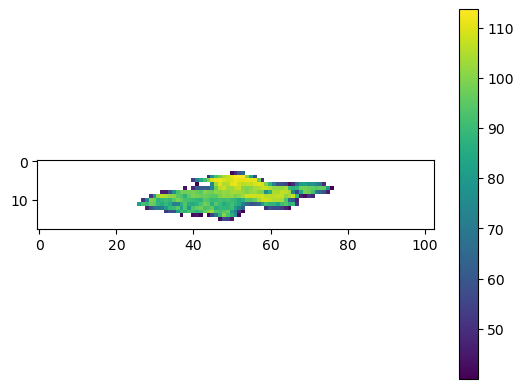

11


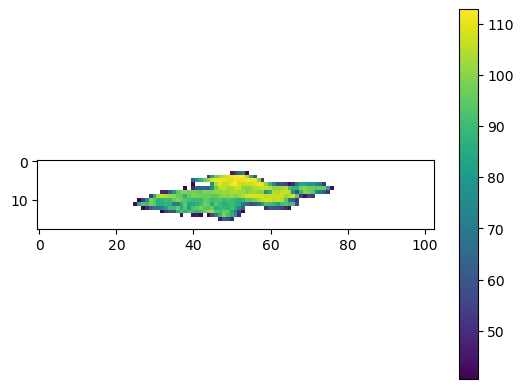

12


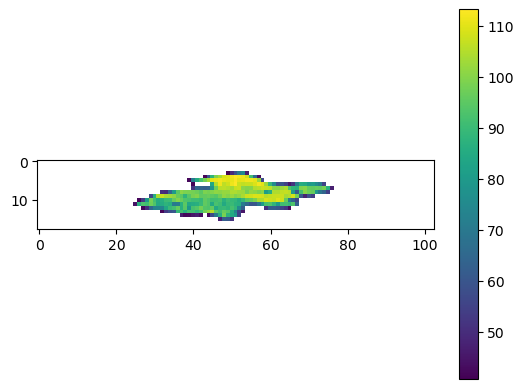

13


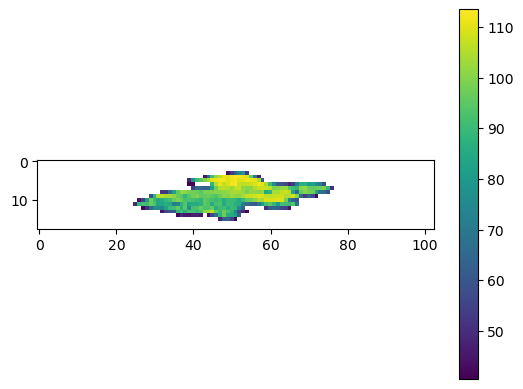

14


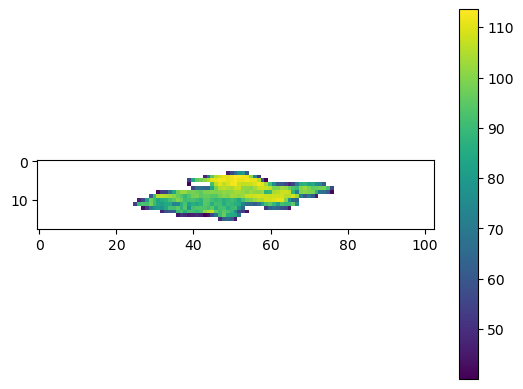

15


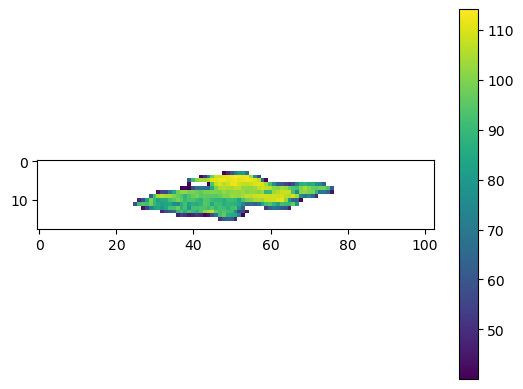

16


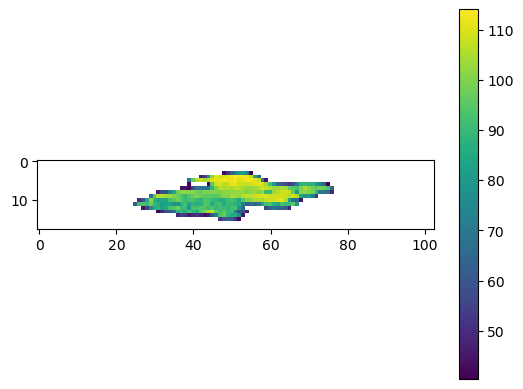

17


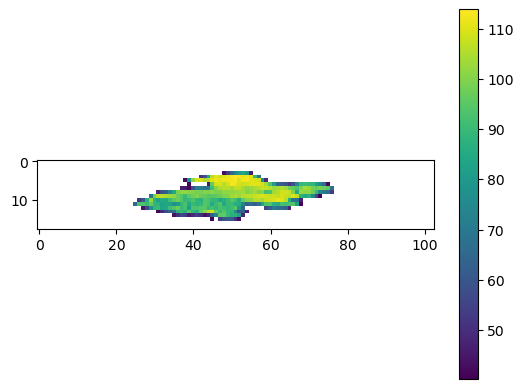

18


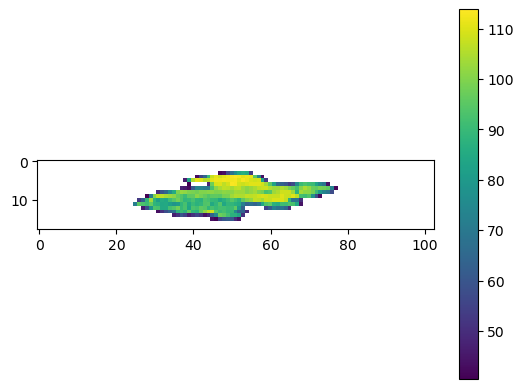

19


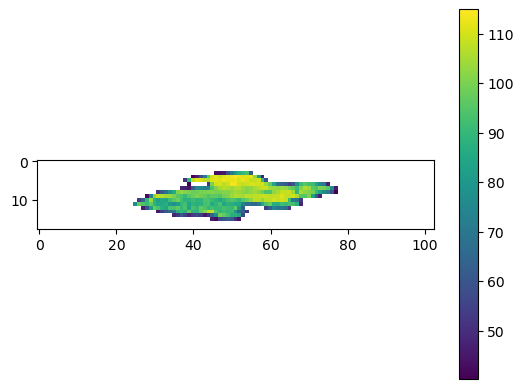

20


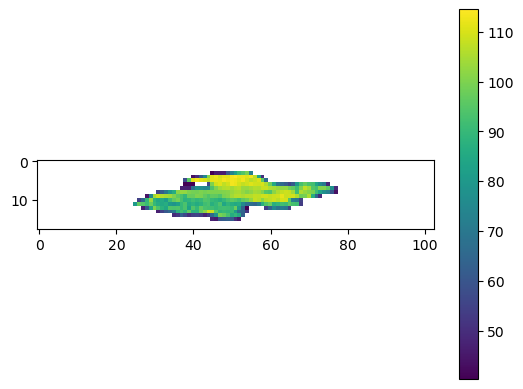

21


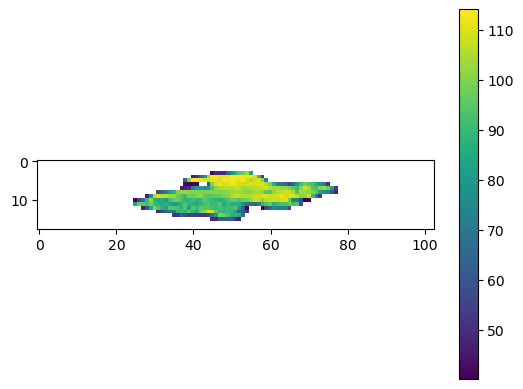

22


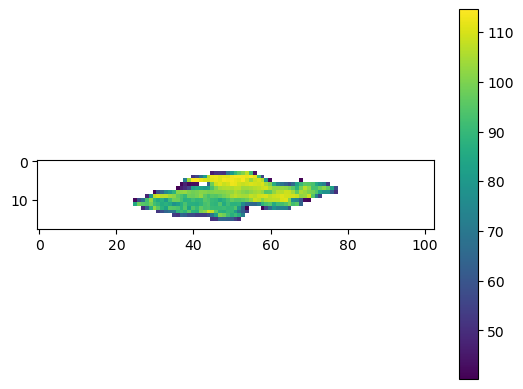

23


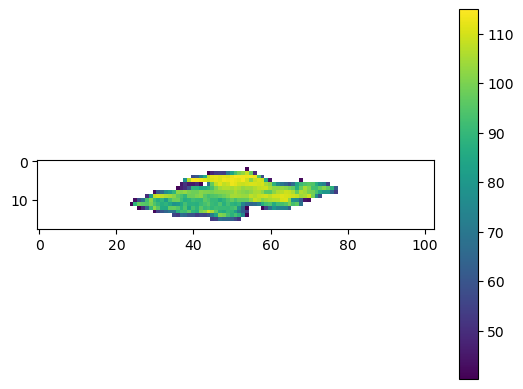

24


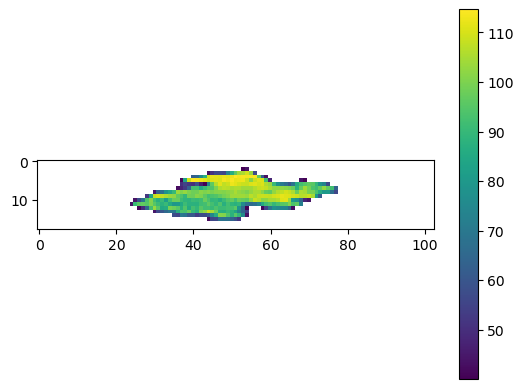

25


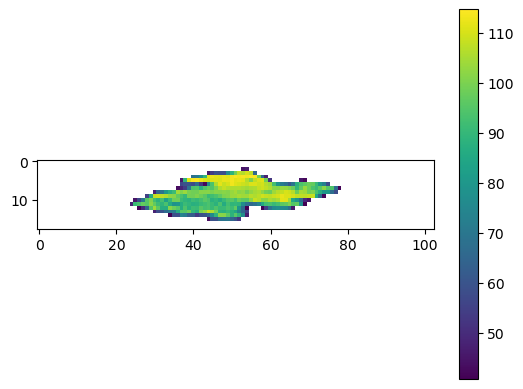

26


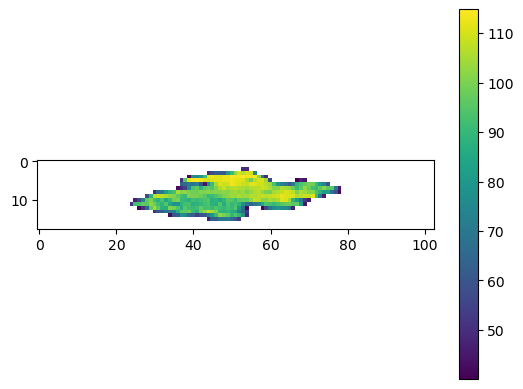

27


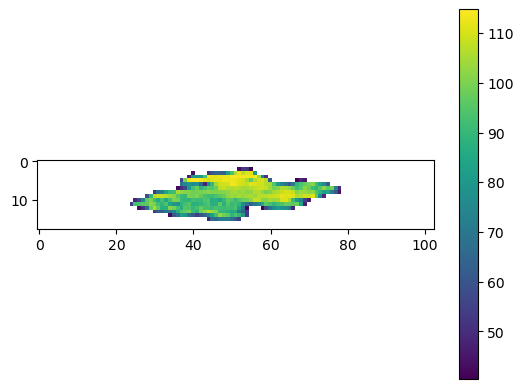

28


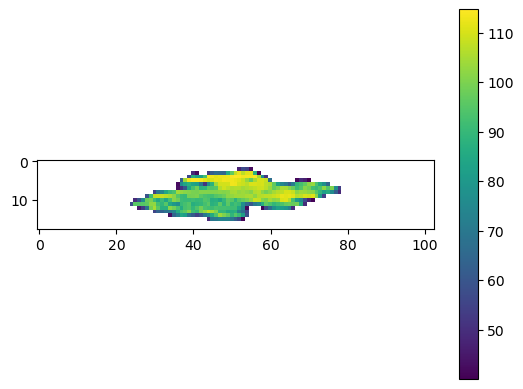

29


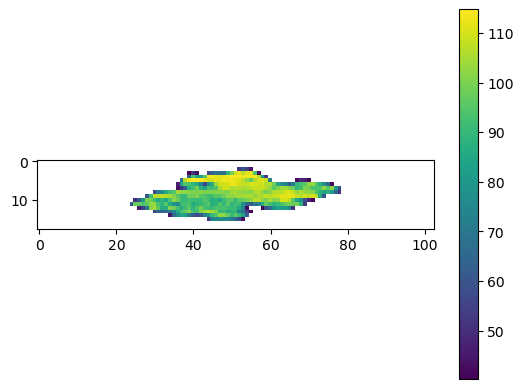

30


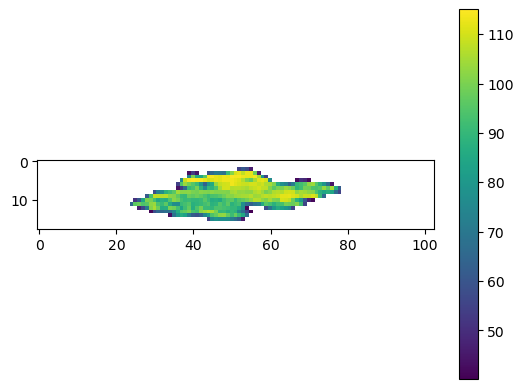

31


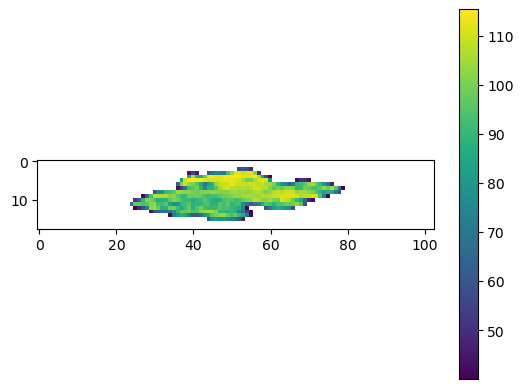

32


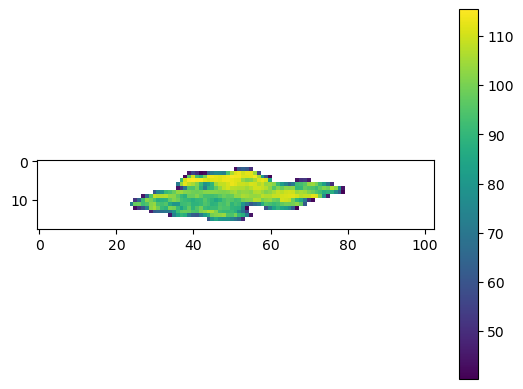

33


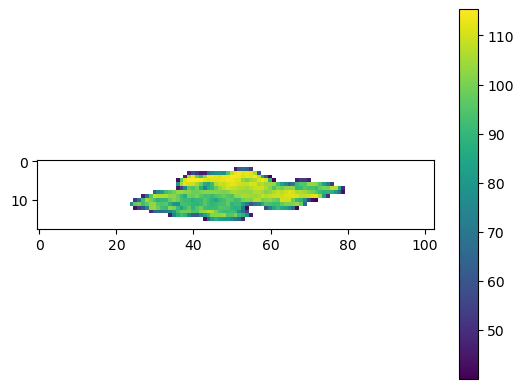

34


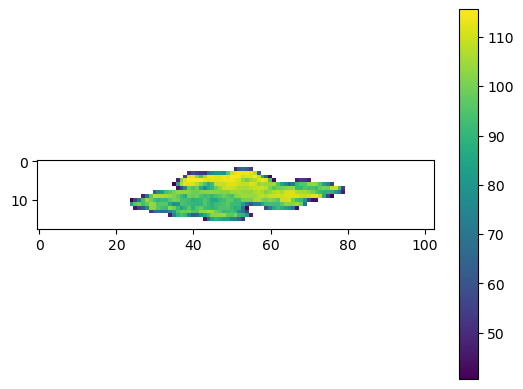

35


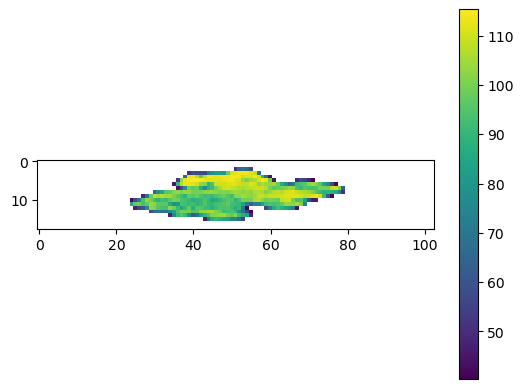

36


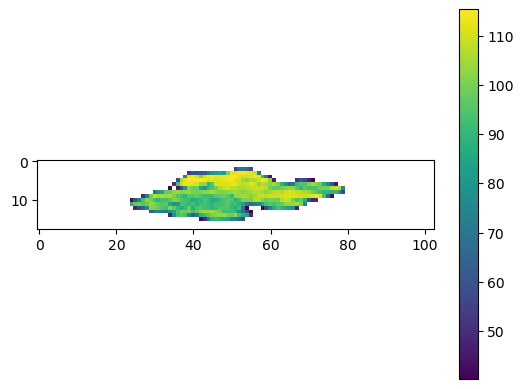

37


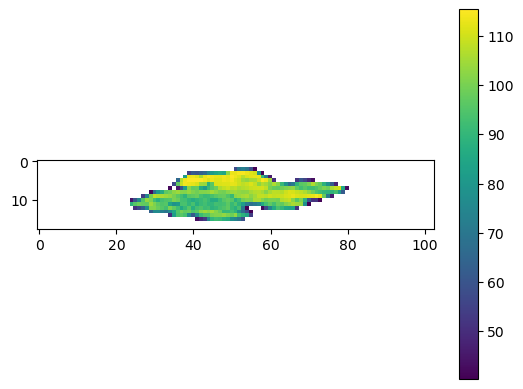

38


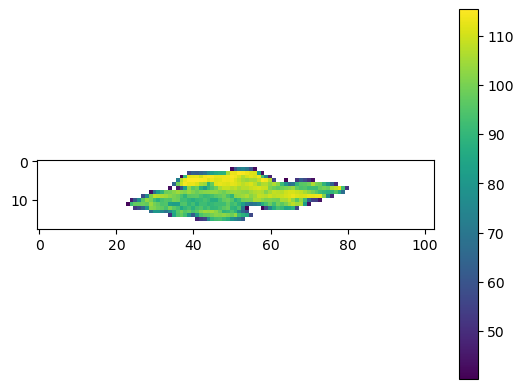

39


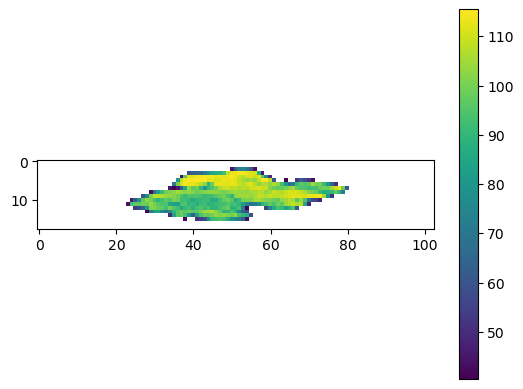

40


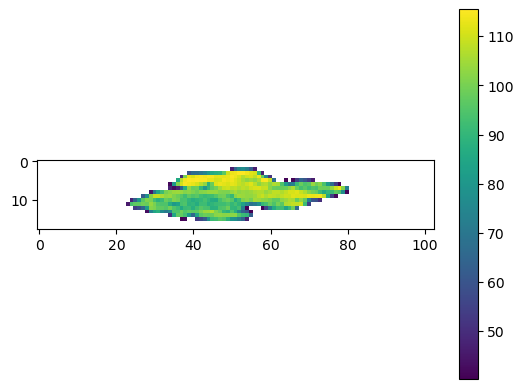

41


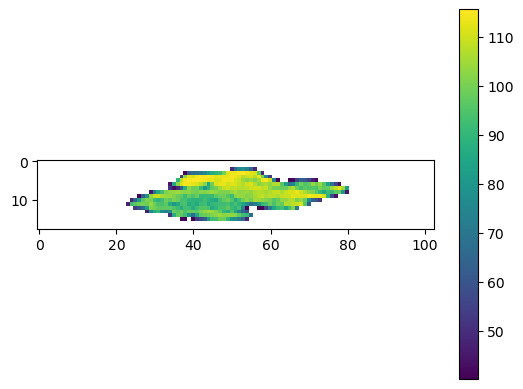

42


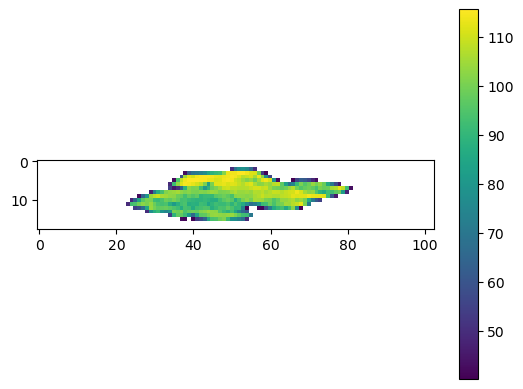

43


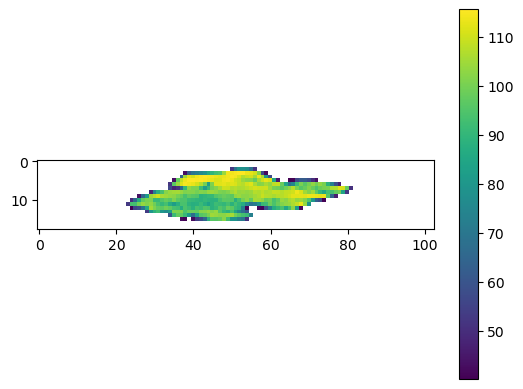

44


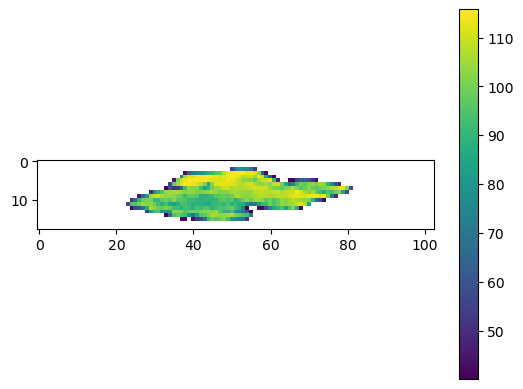

45


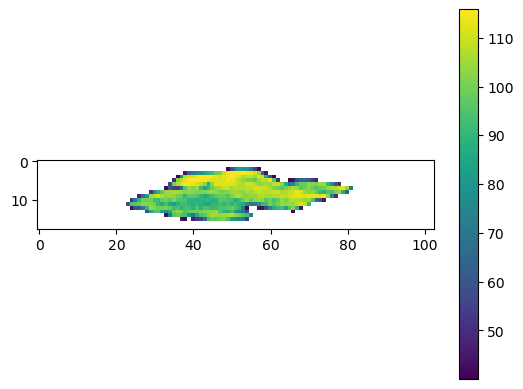

46


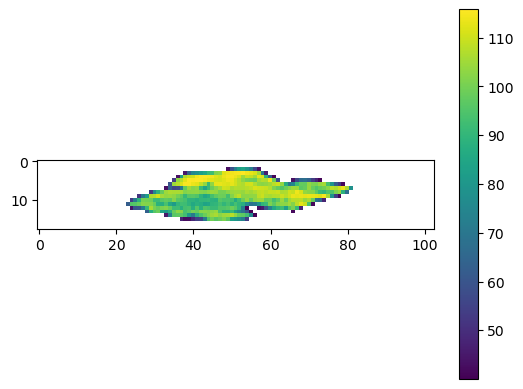

47


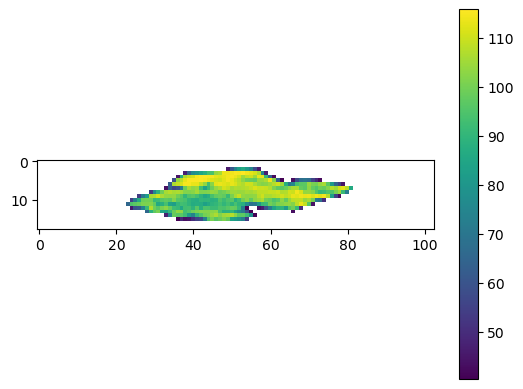

48


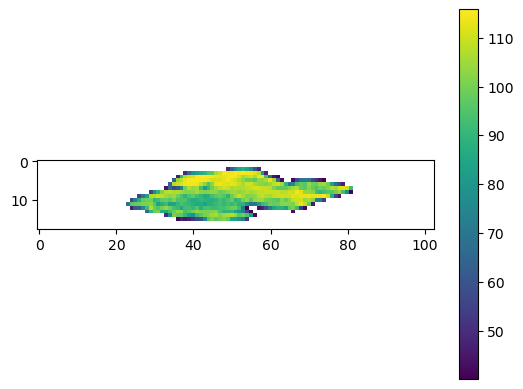

49


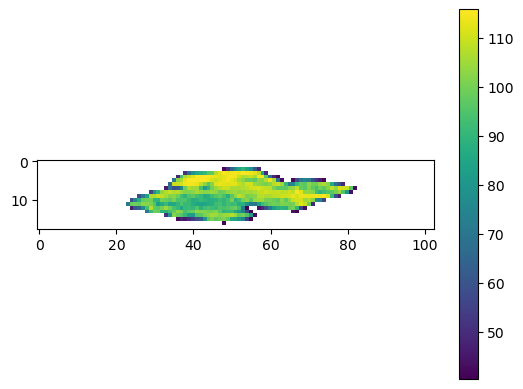

50


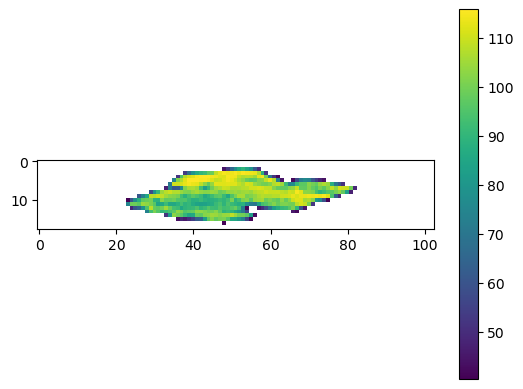

51


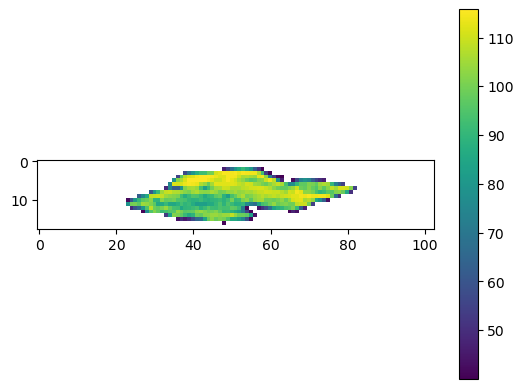

52


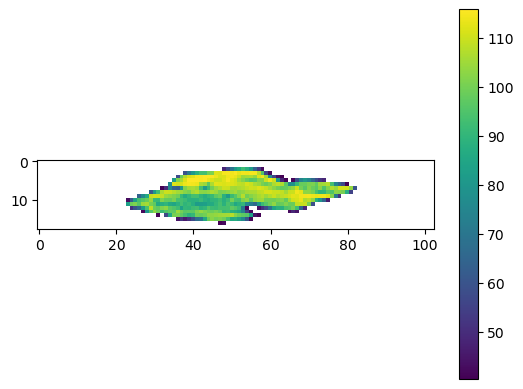

53


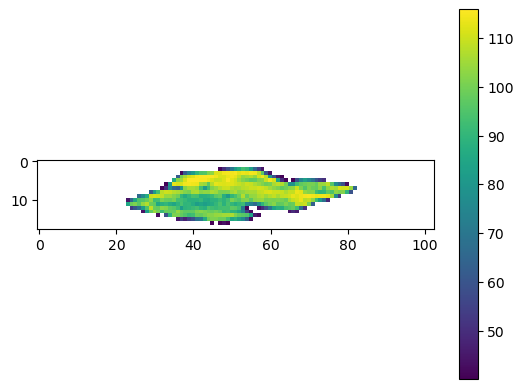

54


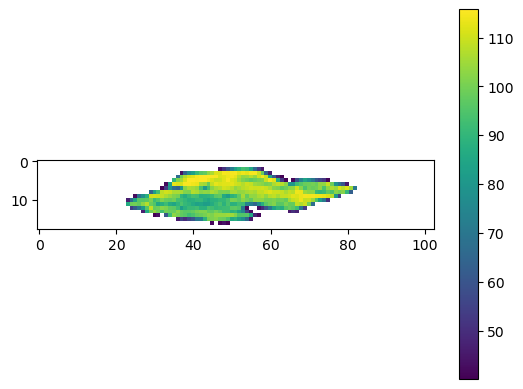

55


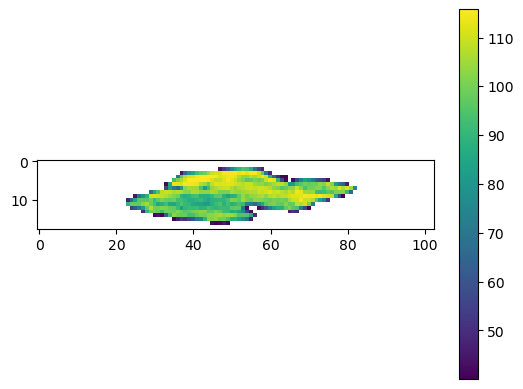

56


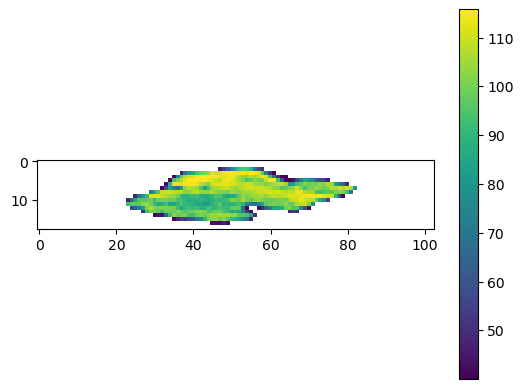

57


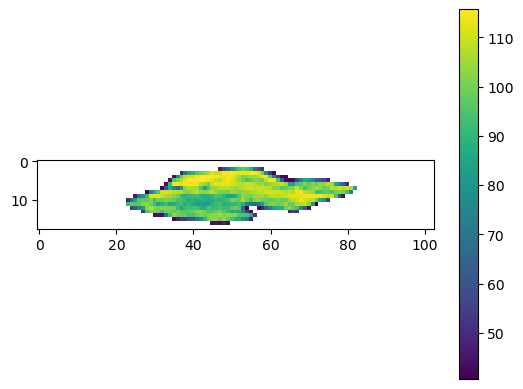

58


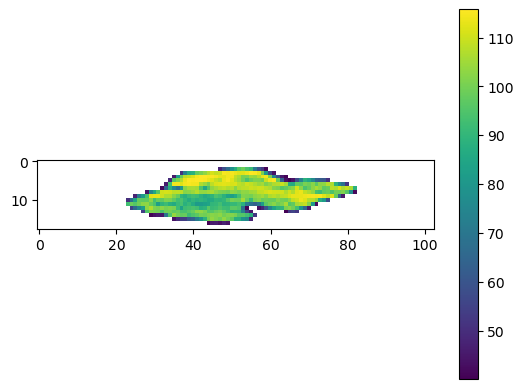

59


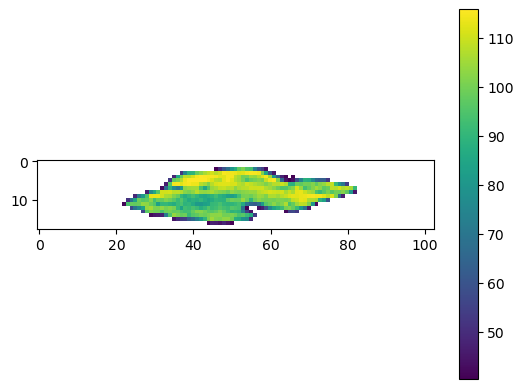

60


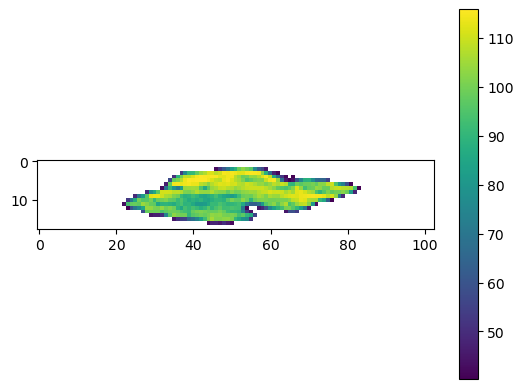

61


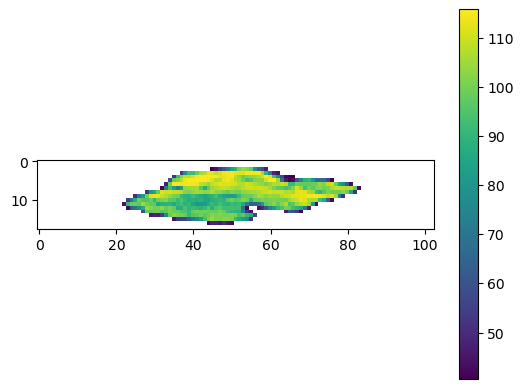

62


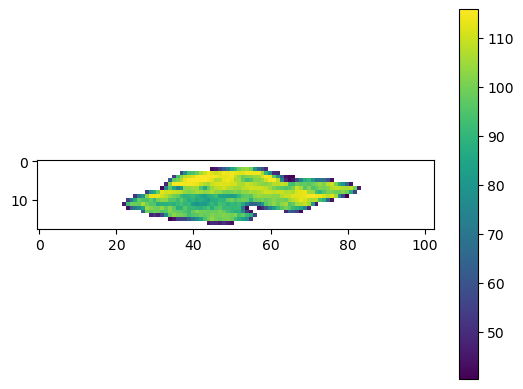

63


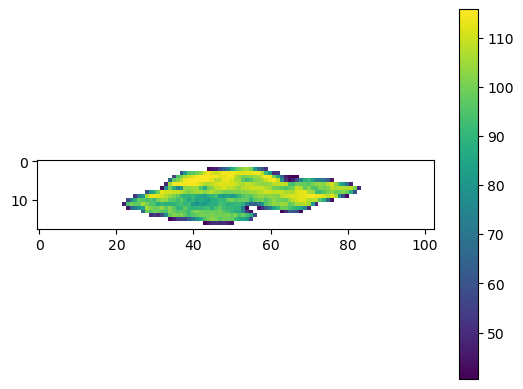

64


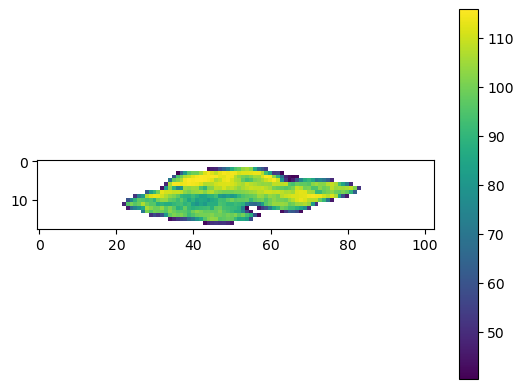

65


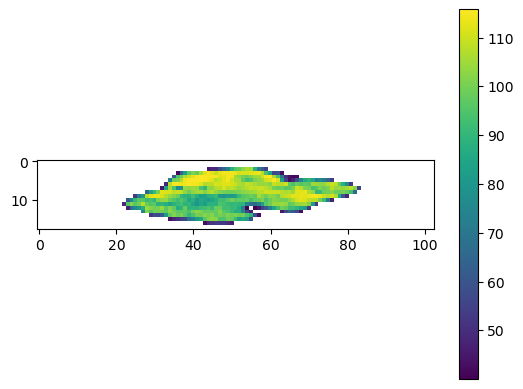

66


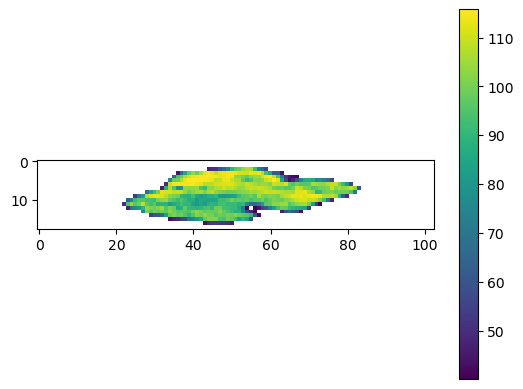

67


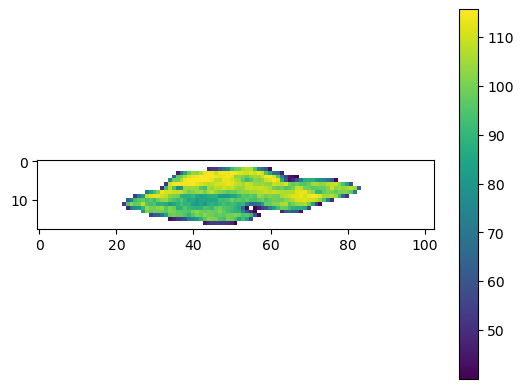

68


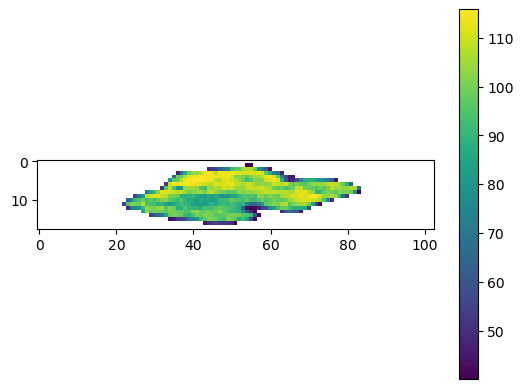

69


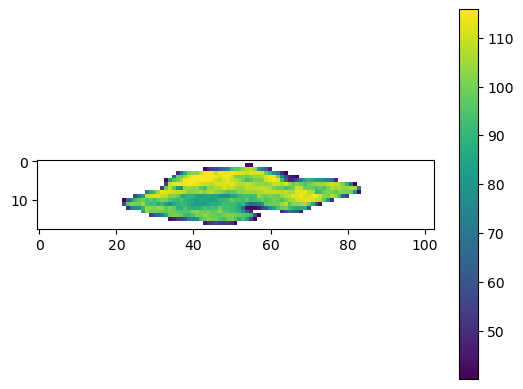

70


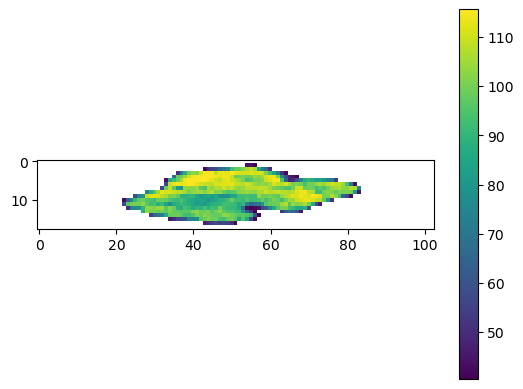

71


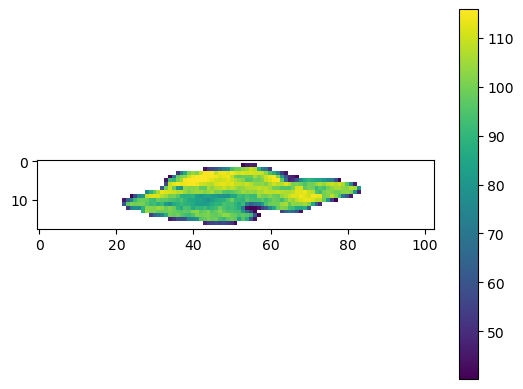

72


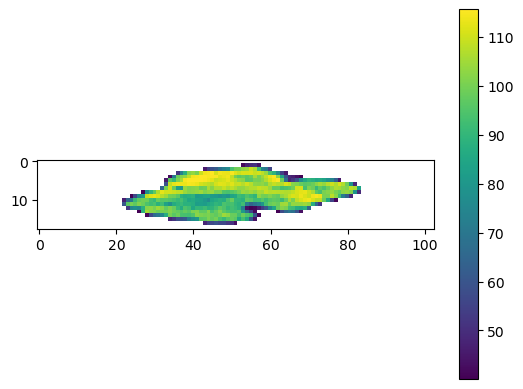

73


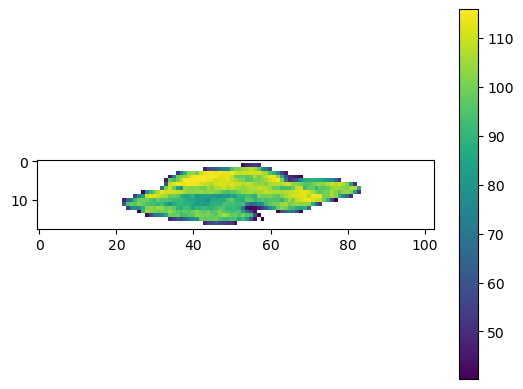

74


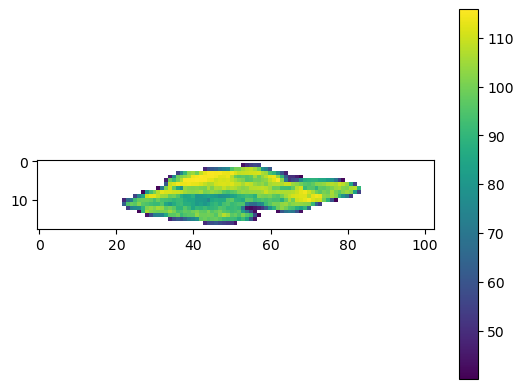

75


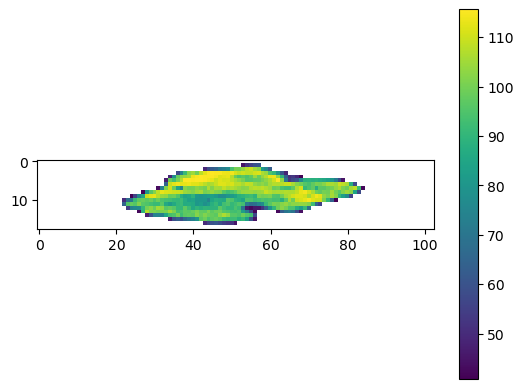

76


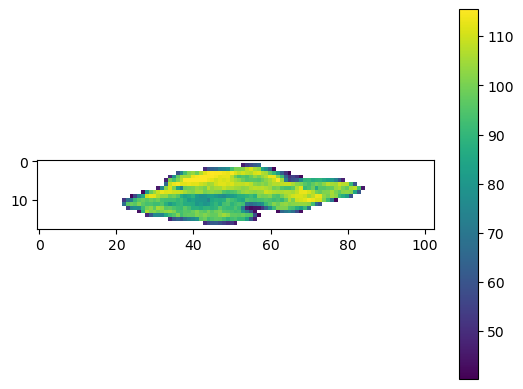

77


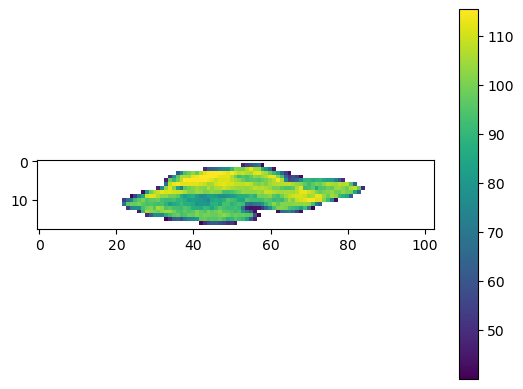

78


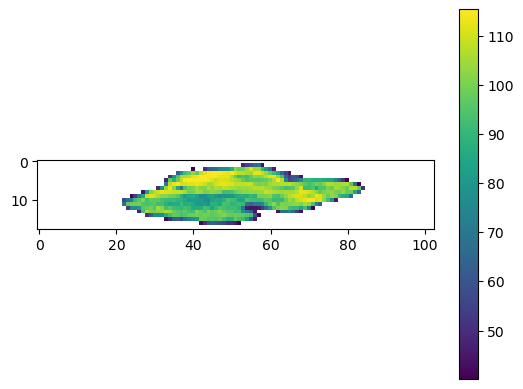

79


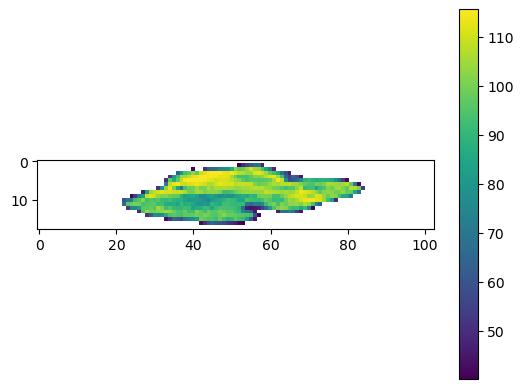

80


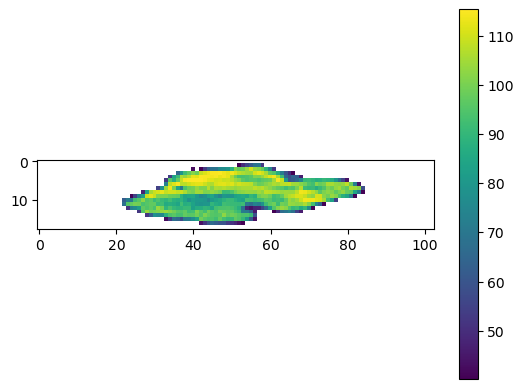

81


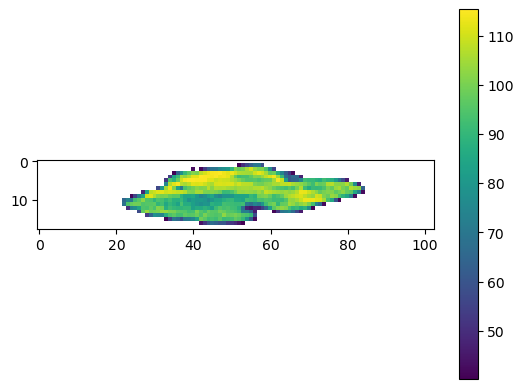

82


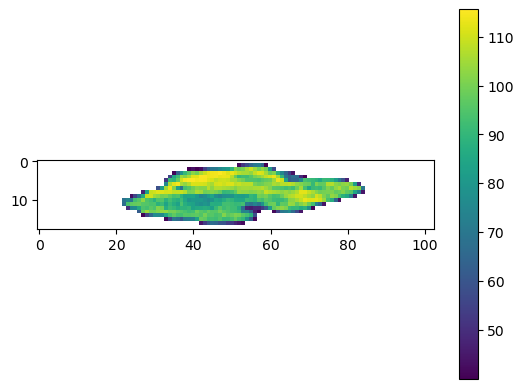

83


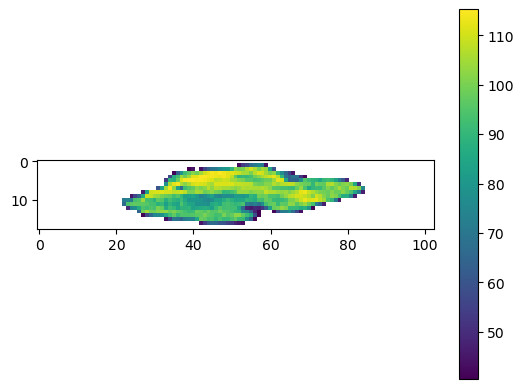

84


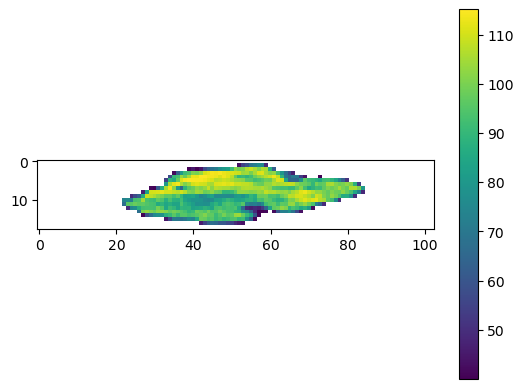

85


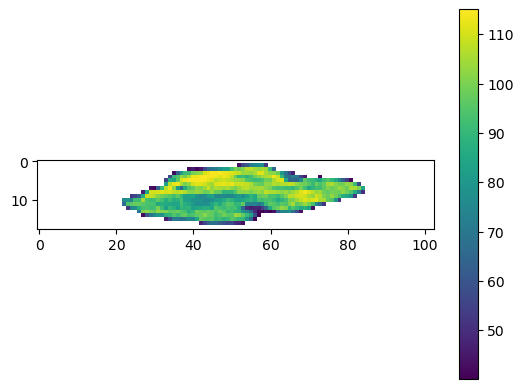

86


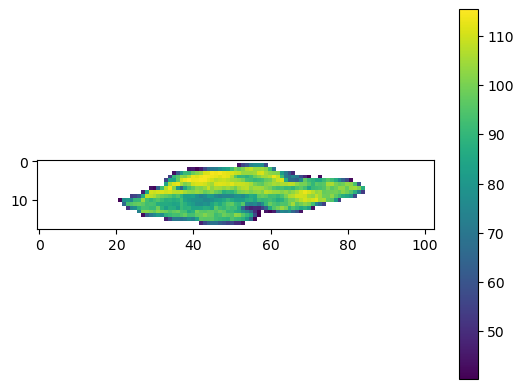

87


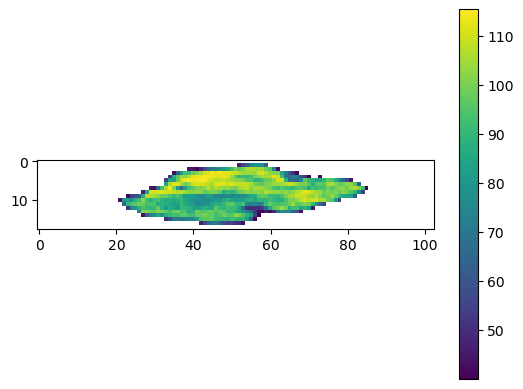

88


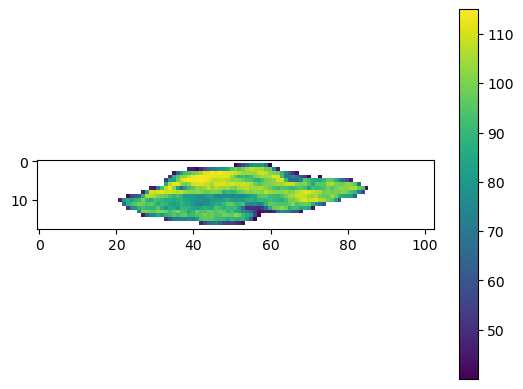

89


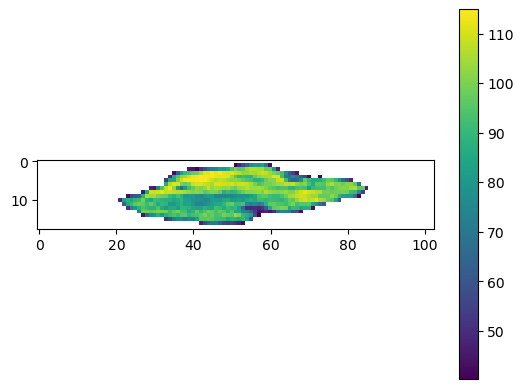

90


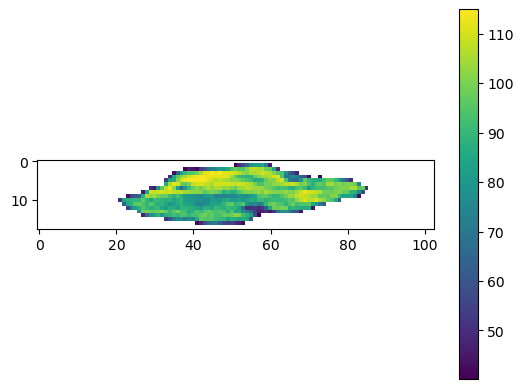

91


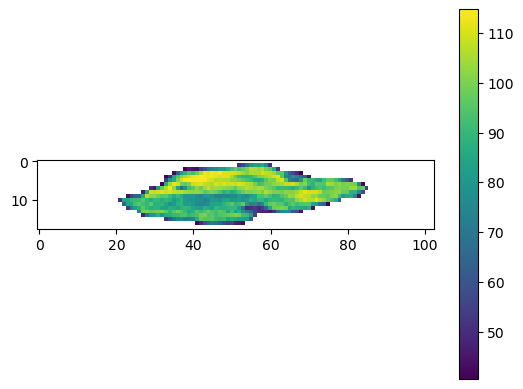

92


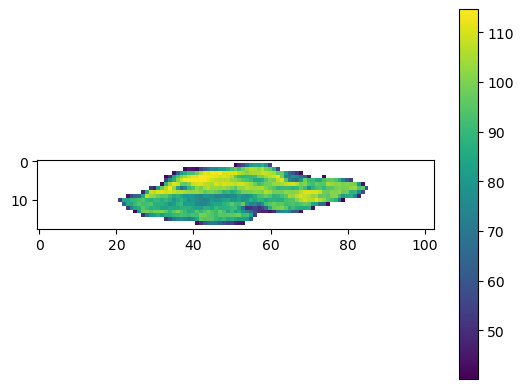

93


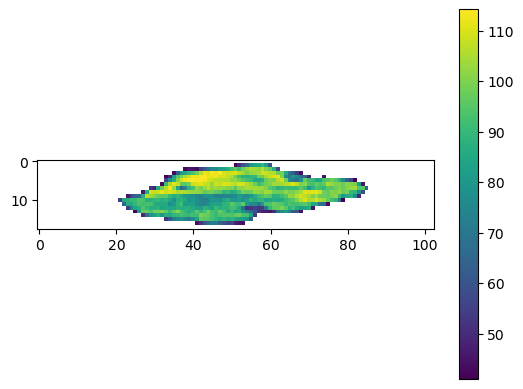

94


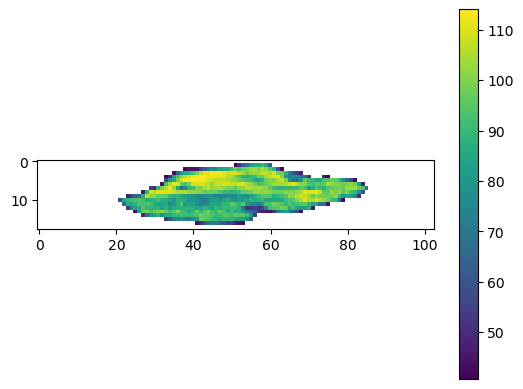

95


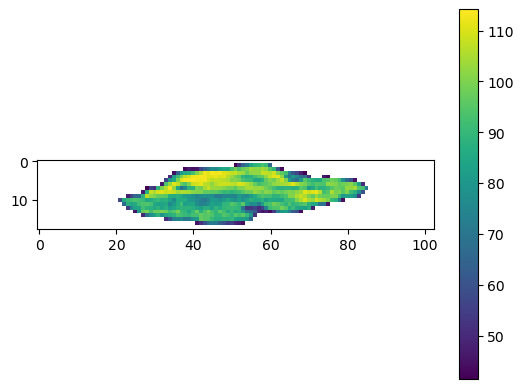

96


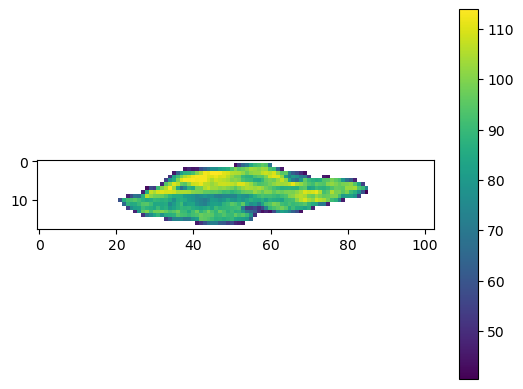

97


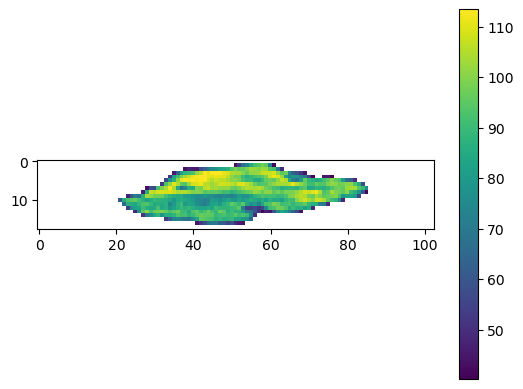

98


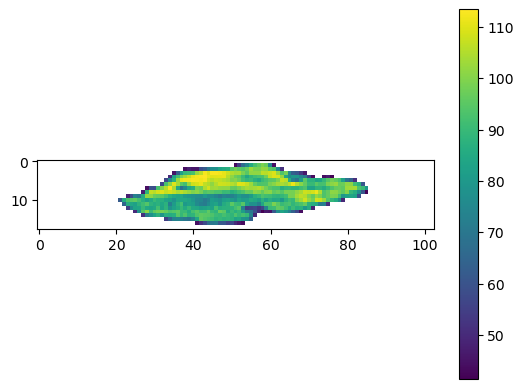

99


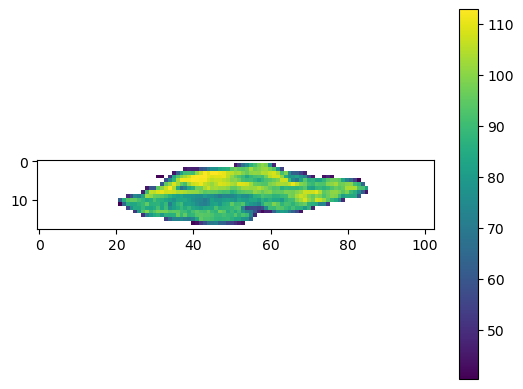

100


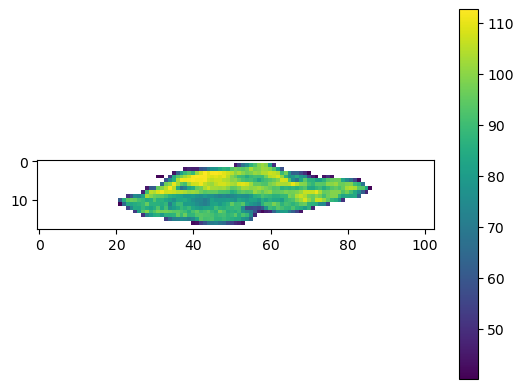

101


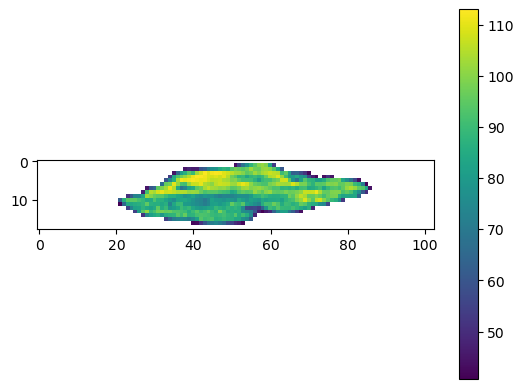

102


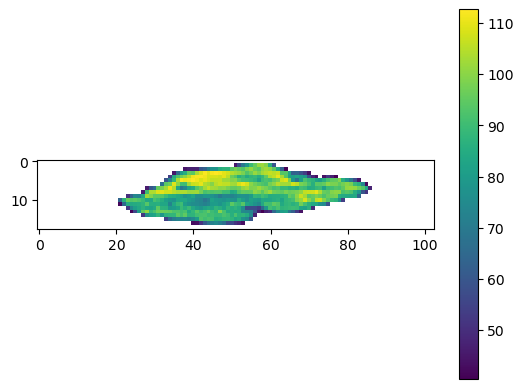

103


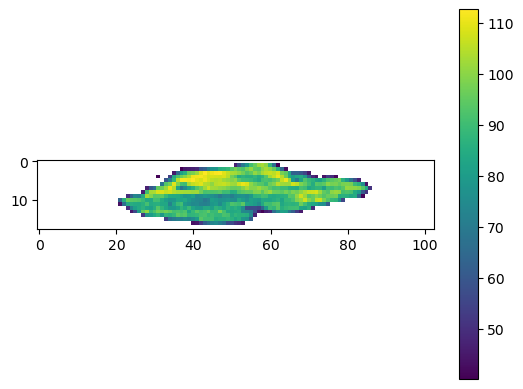

104


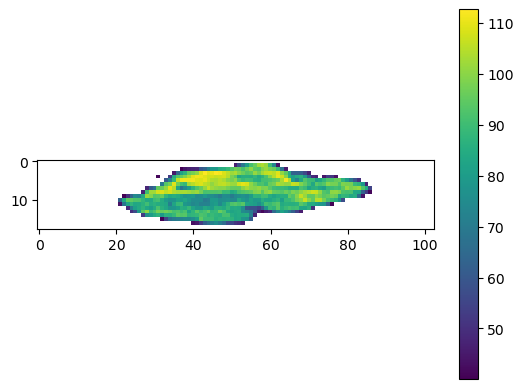

105


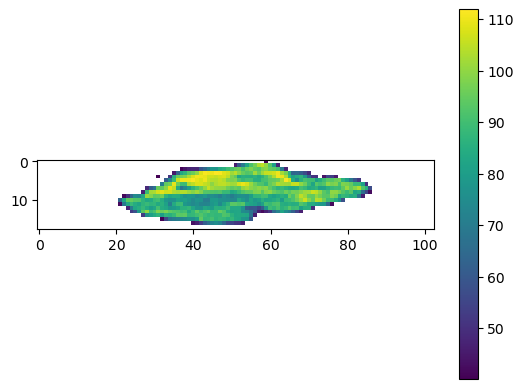

106


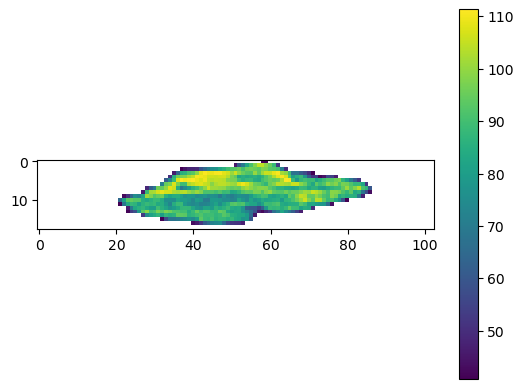

107


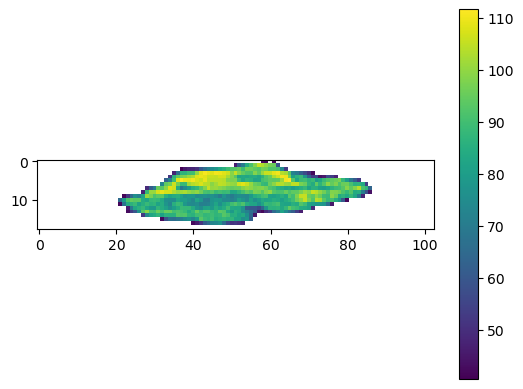

108


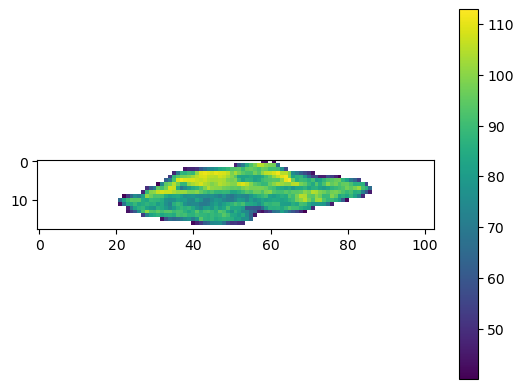

109


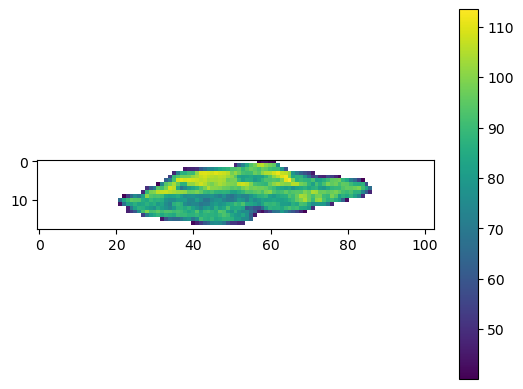

110


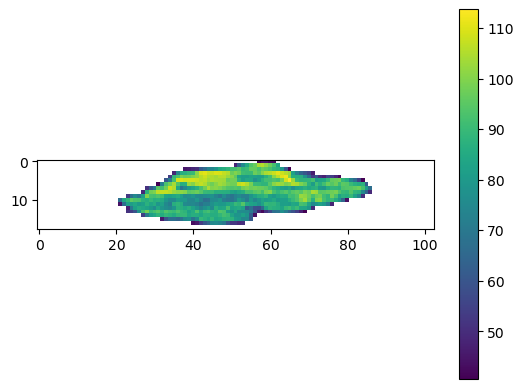

111


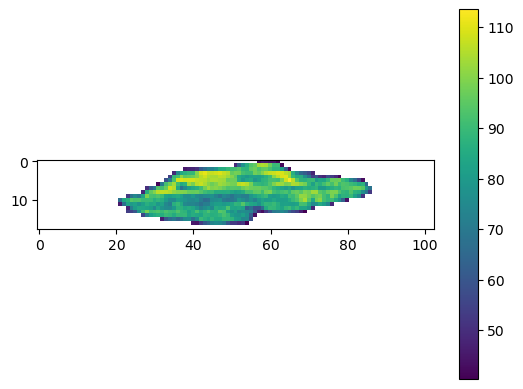

112


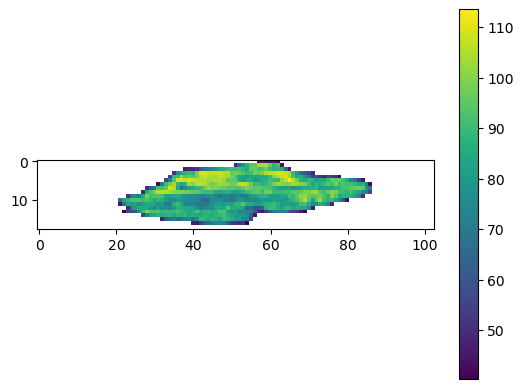

113


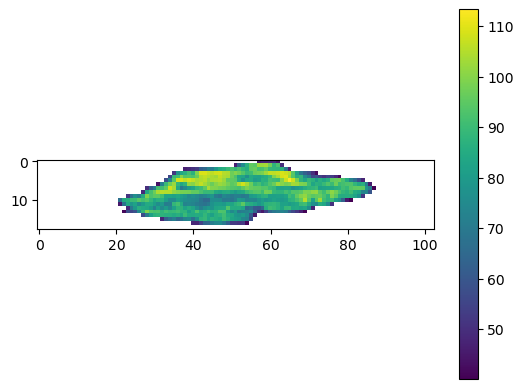

114


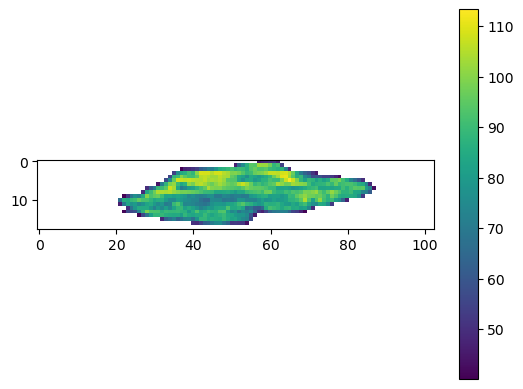

115


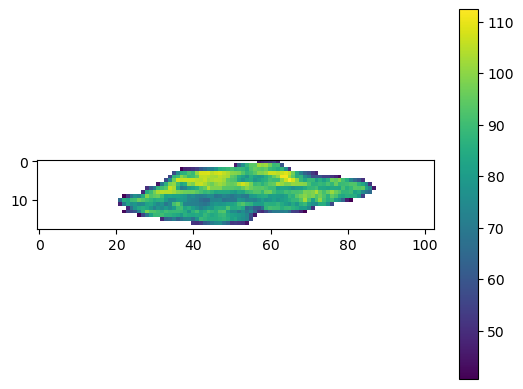

116


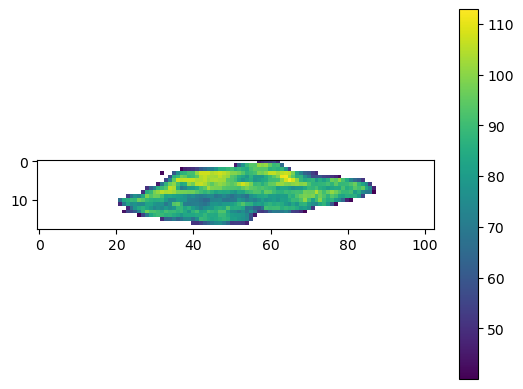

117


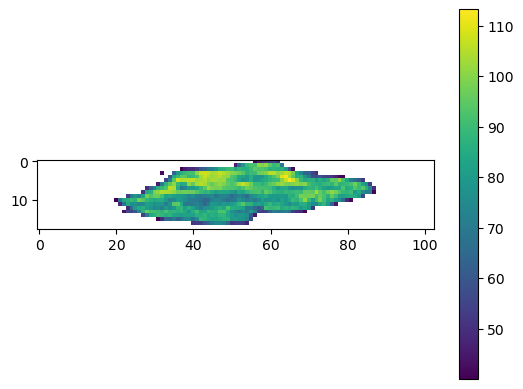

118


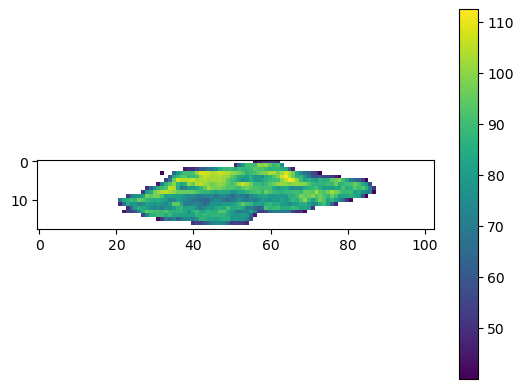

119


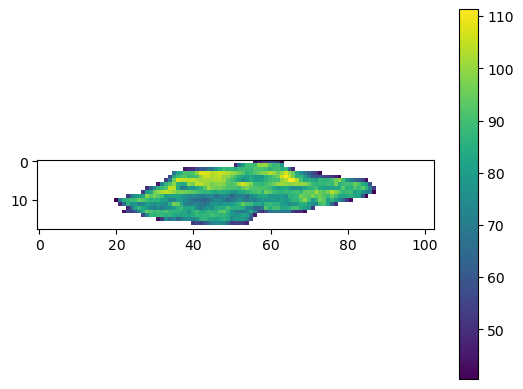

120


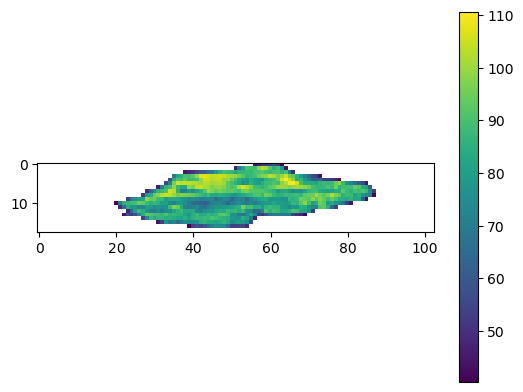

121


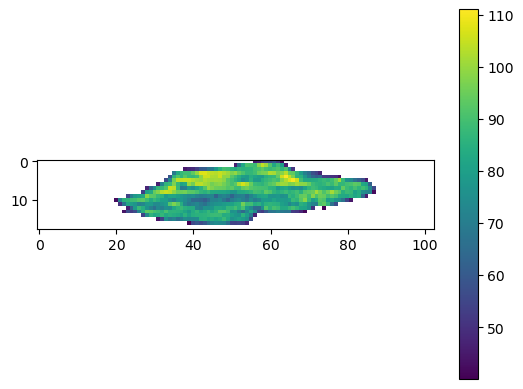

122


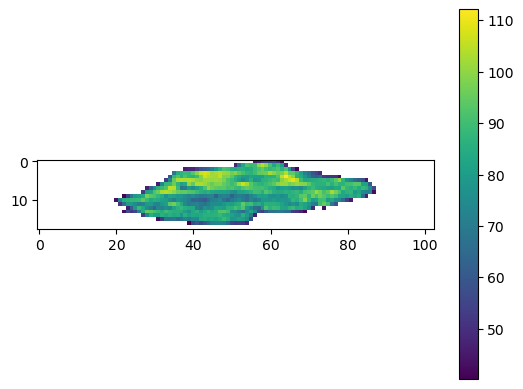

123


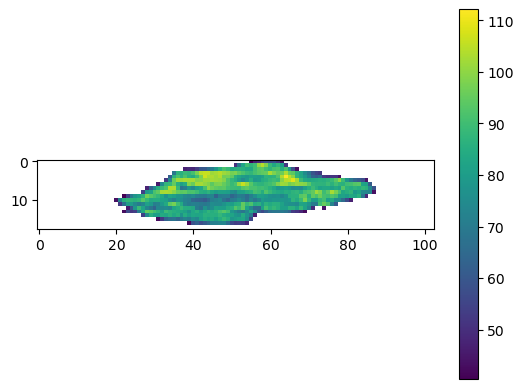

124


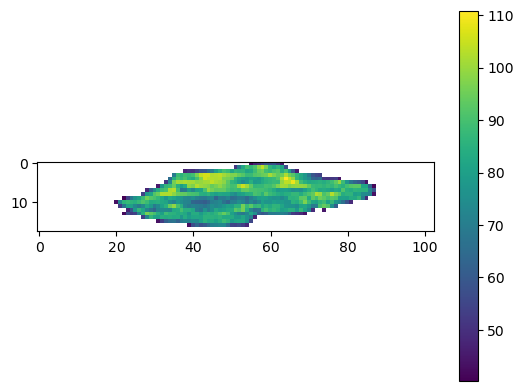

125


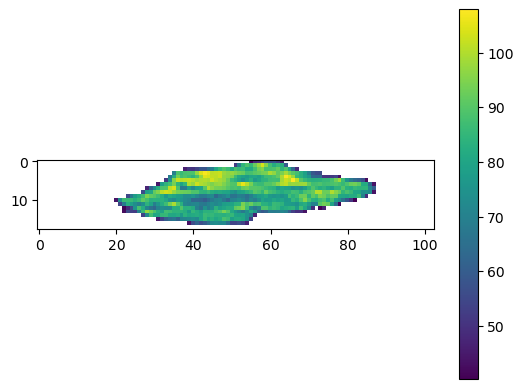

126


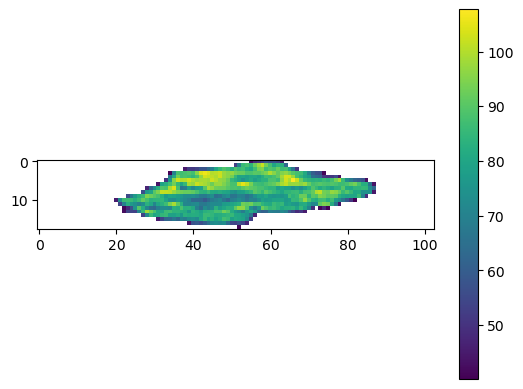

127


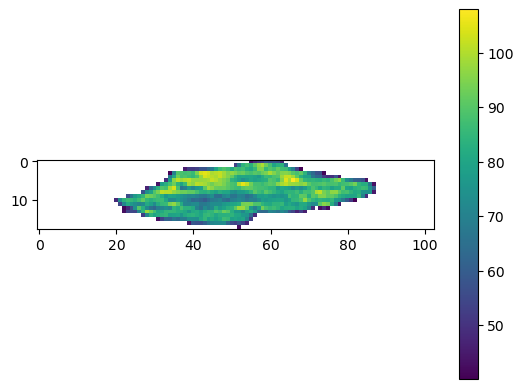

128


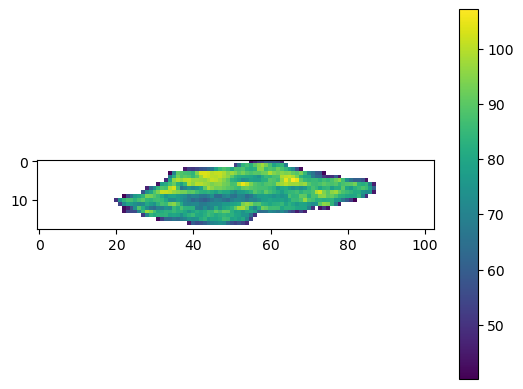

(18, 103, 129)


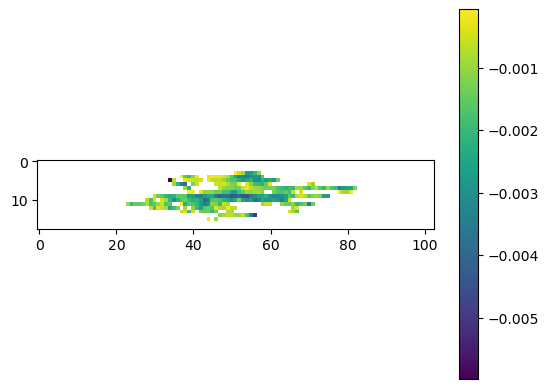

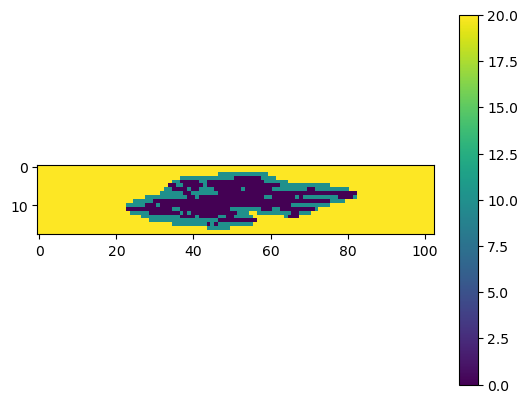

In [15]:
#Attenuation function can be run to be sure selected region works-

def att_mes(oct_cube):
    consec_oct=oct_cube[:,:,:,0]
    #Maybe we could add a bit of normalization to this sitch
    middle=int(np.floor(consec_oct.shape[1]/2))
    print(np.min(consec_oct))
    normconec_oct=150*(consec_oct/np.max(consec_oct[:,middle,:]))
    floor_oct=normconec_oct-np.min(normconec_oct)    
    consec_oct=floor_oct
    
    pixelsize=20
    y_divs=int(np.floor(consec_oct.shape[0]/pixelsize))
    x_divs=int(np.floor(consec_oct.shape[2]/pixelsize))
    mean_array=np.zeros((y_divs,x_divs,consec_oct.shape[1]))
    for j in range(consec_oct.shape[1]):
        oct_layer=consec_oct[:,j,:]
        oct_layer=np.where(oct_layer>200, np.nan, oct_layer)
        print(j)
#         plt.imshow(oct_layer)
#         plt.show()
        for k in range(y_divs):
            for l in range(x_divs):
                lil_square=oct_layer[k*pixelsize:(k+1)*pixelsize,l*pixelsize:(l+1)*pixelsize]
                sqr_mean=np.nanmean(lil_square)
                if sqr_mean>40 and sqr_mean<200:
                    mean_array[k,l,j]=sqr_mean
                else:
                    mean_array[k,l,j]=np.nan
        q=plt.imshow(mean_array[:,:,j])
        plt.colorbar(q)
        plt.show()
    print(mean_array.shape)
    #Adding some restrictions on length of output and
    #empty array to fill with vals-
    meanarray_sorted=np.empty(shape=mean_array.shape)
    attenarray=np.zeros((mean_array.shape[0],mean_array.shape[1]))
    tsarray=np.zeros((mean_array.shape[0],mean_array.shape[1]))
    for m in range(mean_array.shape[0]):
        for n in range(mean_array.shape[1]):
            slicelist=[]
            pixelslice=[]
            for o in range(mean_array.shape[2]):
                pixelval=mean_array[m,n,o]               
                #Going through collecting non-nan values until we get to a nan-
                if not np.isnan(pixelval):
                    pixelslice.append(pixelval)
                    #When we get a nan add pixelvalues to list and start a new list 
                else:
                    #If it's the first nan add list of values to slicelist, otherwise just skip
                    if len(pixelslice)>10:
                        slicelist.append(pixelslice)
                    pixelslice=[]
            #Add handling for sections with no nans-
            slicelist.append(pixelslice)
            #Select longest pixel list in the slice:
            if len(slicelist)>0:
                lenlist=[]
                for elem in slicelist:
                    lenlist.append(len(elem))
                maxindex=np.argmax(np.array(lenlist))
                chosenslice=slicelist[maxindex][10:-10]
                if len(chosenslice)>50:
                   #Apply fit fnc-
                    x=np.arange(len(chosenslice))
                    polyfit=np.polyfit(x,np.log(chosenslice),1,full=True)
                    #fit y=mx+b
                    fit=polyfit[0]
                    #res- how far away from fit-
                    res=polyfit[1]
                    poly=np.poly1d(fit)
                    ynew=poly(x)
#                     plt.plot(np.log(chosenslice))
#                     plt.plot(ynew)                    
#                     plt.show()
                    if res<5 and fit[0]<0:
                        attenarray[m,n]=fit[0]
                    else:
                        attenarray[m,n]=np.nan
                        tsarray[m,n]=10
                    meanarray_sorted[m,n,:len(chosenslice)]=chosenslice
                    meanarray_sorted[m,n,len(chosenslice):]=np.nan
                else:
                    meanarray_sorted[m,n,:]=np.nan
                    attenarray[m,n]=np.nan
                    tsarray[m,n]=20
            else:
                meanarray_sorted[m,n,:]=np.nan
                attenarray[m,n]=np.nan
                tsarray[m,n]=30
    f=plt.imshow(attenarray)
    plt.colorbar(f)
    plt.show()
    finalmean=np.nanmean(attenarray)
    g=plt.imshow(tsarray)
    plt.colorbar(g)
    plt.show()
    
    return(finalmean)

oct_mean=att_mes(oct_cube_new) 